In [1]:
from hest import iter_hest, XeniumReader
from hest.HESTData import *
from hest import h5ad_reader
from hest.h5ad_reader import *
import dask
dask.config.set({'dataframe.query-planning': False})
from pathlib import Path
import hest
print(hest.__version__)
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# check gpu cucim
import cucim
print(cucim.__version__)
from cucim import CuImage

0.0.1


ModuleNotFoundError: No module named 'cucim'

# development code

In [2]:
# def coord_range(arr):
#     return float(np.nanmin(arr[:,0])), float(np.nanmax(arr[:,0])), \
#            float(np.nanmin(arr[:,1])), float(np.nanmax(arr[:,1]))

# def plot_cell(st_adata, adata_labelled, save_dir, fname="cell_plot.png"):
#     """
#     Overlay spatial spots (colored by log1p_total_counts) with labelled cells (colored by cell_type).
#     Saves a figure with the legend (cell types) and colorbar (spots).
#     """
#     save_dir = Path(save_dir)
#     save_dir.mkdir(parents=True, exist_ok=True)
#     outpath = save_dir / fname

#     fig, ax = plt.subplots(figsize=(8, 8))

#     # spots colored by total_counts
#     sc = ax.scatter(
#         st_adata.obsm["spatial"][:, 0],
#         st_adata.obsm["spatial"][:, 1],
#         c=st_adata.obs["log1p_total_counts"],
#         s=8, alpha=0.6, cmap="viridis", label="spots"
#     )

#     # cells colored by cell_type categories
#     cell_types = adata_labelled.obs["cell_type"].astype("category")
#     colors = plt.cm.tab20(np.linspace(0, 1, len(cell_types.cat.categories)))

#     for color, ct in zip(colors, cell_types.cat.categories):
#         mask = cell_types == ct
#         ax.scatter(
#             adata_labelled.obsm["spatial"][mask, 0],
#             adata_labelled.obsm["spatial"][mask, 1],
#             c=[color], s=2, alpha=0.6, label=ct
#         )

#     ax.invert_yaxis()
#     ax.set_title("Overlay: spots (counts) and cells (labels)")

#     # put legend on the right
#     leg = ax.legend(markerscale=4, bbox_to_anchor=(1.05, 1), loc="upper left")

#     # add a horizontal colorbar just below the legend
#     # create a new axes for the colorbar
#     fig.subplots_adjust(right=0.8)  # make space for legend+colorbar
#     cbar_ax = fig.add_axes([0.82, 0.1, 0.02, 0.35])  # [left, bottom, width, height]
#     cbar = fig.colorbar(sc, cax=cbar_ax)
#     cbar.set_label("total_counts")

#     plt.tight_layout()
#     plt.savefig(outpath, dpi=300, bbox_inches="tight")
#     plt.close(fig)

#     print(f"Overlay plot saved to: {outpath}")
#     return outpath

# def fast_spatial(adata, x, y, spot_size=2, max_cells=10000, color=None, cmap='viridis'):
#     """
#     Fast spatial plotting using centroid coordinates from Seurat-converted AnnData.
    
#     adata: AnnData object
#     x, y: obs column names for coordinates
#     spot_size: size of points
#     max_cells: max number of cells to plot (random subsample for speed)
#     color: optional, name of obs column or var (gene) to color by
#     cmap: colormap for continuous values
#     """
#     # Subsample if needed
#     if adata.n_obs > max_cells:
#         idx = np.random.choice(adata.n_obs, max_cells, replace=False)
#         adata_plot = adata[idx, :]
#     else:
#         adata_plot = adata

#     x_vals = adata_plot.obs[x]
#     y_vals = adata_plot.obs[y]

#     # Handle color
#     if color is None:
#         c = "grey"
#     elif color in adata_plot.obs.columns:
#         c = adata_plot.obs[color]
#     elif color in adata_plot.var_names:  # gene name
#         c = adata_plot[:, color].X.toarray().flatten()
#     else:
#         raise ValueError(f"{color} not found in .obs or .var")

#     plt.figure(figsize=(6, 6))
#     sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)
#     plt.gca().invert_yaxis()  # match spatial orientation
#     plt.title(f"Spatial plot ({color if color else 'no color'})")

#     if color is not None:
#         plt.colorbar(sc, label=color)

#     plt.show()

To speed up Xenium reader, use module load py-nvidia-rapids  # contains cucim

It requires gpu-ada

In [ ]:
#sys.path.insert(0,'/home/k/kxu/.local/lib/python3.12/site-packages')
#import sys ; sys.path.insert(0,'/home/k/kxu/.local/lib/python3.11/site-packages')

In [ ]:
# check gpu
# import subprocess

# try:
#     result = subprocess.run(["nvidia-smi"], capture_output=True, text=True, check=True)
#     print(result.stdout)
# except FileNotFoundError:
#     print("nvidia-smi not found (no NVIDIA driver or GPU not available).")
# except subprocess.CalledProcessError as e:
#     print("Error running nvidia-smi:", e.stderr)

# Slide 1 - 43739

## CAM006

In [4]:
# # Base stem for experiment outputs (10 min)
# exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/"
#                 "20241113__143534__SIMMONS_super_secret_prime_run1/"
#                 "output-XETG00283__0043739__Region_1__20241113__143611")

# st = XeniumReader().read(
#     img_path="/project/simmons_hts/jpark/1_project/0_xenium/"
#              "RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE.ome.tif",
#     experiment_path=exp_stem / "experiment.xenium",
#     alignment_file_path= '/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE_matrix.csv',
#     feature_matrix_path=exp_stem / "cell_feature_matrix.h5",
#     transcripts_path=exp_stem / "transcripts.parquet",
#     cells_path=exp_stem / 'cells.parquet',
#     nucleus_bound_path=exp_stem / 'nucleus_boundaries.parquet',
#     cell_bound_path=exp_stem / 'cell_boundaries.parquet',
#     dapi_path=exp_stem / 'morphology_focus/morphology_focus_0000.ome.tif',
#     use_dask=True
# )

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [5]:
st

        'pixel_size' is 0.4353514884015406
        'wsi' is <width=8851, height=8585, backend=NumpyWSI>
        'shapes': [name: tenx_cell, coord-system: dapi, <not loaded>, name: tenx_cell, coord-system: he, <not loaded>, name: tenx_nucleus, coord-system: dapi, <not loaded>, name: tenx_nucleus, coord-system: he, <not loaded>]

In [6]:
# # ST (adata):
# adata = st.adata
# print('\n* Scanpy adata:')
# print(adata)
# adata_hest = adata # backup

# # WSI:
# wsi = st.wsi
# print('\n* WSI:')
# print(wsi)

# # Shapes:
# shapes = st.shapes
# print('\n* Shapes:')
# print(shapes)

# # Cell (adata):
# cell_adata = st.cell_adata
# print('\n* Scanpy cell_adata:')
# print(cell_adata)

# # metadata:
# metadata = st.meta
# print('\n* Metadata:')
# print(metadata)


* Scanpy adata:
AnnData object with n_obs × n_vars = 22171 × 9655
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

* WSI:
<width=8851, height=8585, backend=NumpyWSI>

* Shapes:
[name: tenx_cell, coord-system: dapi, <not loaded>, name: tenx_cell, coord-system: he, <not loaded>, name: tenx_nucleus, coord-system: dapi, <not loaded>, name: tenx_nucleus, coord-system: he, <not loaded>]

* Scanpy cell_adata:
AnnData object with n_obs × n_vars = 1074150 × 5100
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_

In [8]:
# # Check the keys in adata.uns["spatial"]
# print("Keys in adata.uns['spatial']:", st.adata.uns['spatial'].keys())

# # Inspect the ST slot
# spatial_ST = st.adata.uns['spatial']['ST']
# print("Keys in adata.uns['spatial']['ST']:", spatial_ST.keys())

# # Images available
# images = spatial_ST.get('images', {})
# print("Images available:", list(images.keys()))
# for k, v in images.items():
#     print(f"  {k}: type={type(v)}, shape={getattr(v, 'shape', 'N/A')}")

# # Scale factors
# scalefactors = spatial_ST.get('scalefactors', {})
# print("Scale factors available:", scalefactors)
# for k, v in scalefactors.items():
#     print(f"  {k}: {v}")

Keys in adata.uns['spatial']: dict_keys(['ST'])
Keys in adata.uns['spatial']['ST']: dict_keys(['images', 'scalefactors'])
Images available: ['downscaled_fullres']
  downscaled_fullres: type=<class 'numpy.ndarray'>, shape=(970, 1000, 3)
Scale factors available: {'spot_diameter_fullres': 126.3347007309907, 'tissue_downscaled_fullres_scalef': 0.1129815840018077}
  spot_diameter_fullres: 126.3347007309907
  tissue_downscaled_fullres_scalef: 0.1129815840018077


In [8]:
# downscaled_img = st.adata.uns['spatial']['ST']['images']['downscaled_fullres']

# # Plot
# plt.figure(figsize=(8, 8))
# plt.imshow(downscaled_img)
# plt.axis('off')
# plt.title("Downscaled Image")
# plt.show()

In [3]:
# def fast_spatial(adata, x, y, spot_size=2, max_cells=10000, color=None, cmap='viridis'):
#     """
#     Fast spatial plotting using centroid coordinates from Seurat-converted AnnData.
    
#     adata: AnnData object
#     x, y: obs column names for coordinates
#     spot_size: size of points
#     max_cells: max number of cells to plot (random subsample for speed)
#     color: optional, name of obs column or var (gene) to color by
#     cmap: colormap for continuous values
#     """
#     # Subsample if needed
#     if adata.n_obs > max_cells:
#         idx = np.random.choice(adata.n_obs, max_cells, replace=False)
#         adata_plot = adata[idx, :]
#     else:
#         adata_plot = adata

#     x_vals = adata_plot.obs[x]
#     y_vals = adata_plot.obs[y]

#     # Handle color
#     if color is None:
#         c = "grey"
#     elif color in adata_plot.obs.columns:
#         c = adata_plot.obs[color]
#     elif color in adata_plot.var_names:  # gene name
#         c = adata_plot[:, color].X.toarray().flatten()
#     else:
#         raise ValueError(f"{color} not found in .obs or .var")

#     plt.figure(figsize=(6, 6))
#     sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)
#     plt.gca().invert_yaxis()  # match spatial orientation
#     plt.title(f"Spatial plot ({color if color else 'no color'})")

#     if color is not None:
#         plt.colorbar(sc, label=color)

#     plt.show()

### Filter AnnData to only include the bits under image

In [10]:
# adata = st.adata

# # 1) Get pixel coords on the H&E (prefer obsm['spatial'] if present)
# if 'spatial' in adata.obsm_keys():
#     xy = adata.obsm['spatial']
#     x = np.asarray(xy[:, 0])    # column (x)
#     y = np.asarray(xy[:, 1])    # row (y)
# else:
#     # fallback to Scanpy-style columns
#     x = adata.obs['pxl_col_in_fullres'].to_numpy()
#     y = adata.obs['pxl_row_in_fullres'].to_numpy()

# # 2) Get the size of THIS piece’s H&E WSI (the one you passed in img_path)
# W = st.wsi.width
# H = st.wsi.height

# # 3) Keep only points that lie inside this WSI
# mask = (x >= 0) & (y >= 0) & (x < W) & (y < H)
# adata_piece = adata[mask].copy()

# print(adata.shape, '->', adata_piece.shape)

(22171, 9655) -> (1260, 9655)


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [11]:
# # visualize the spots over a downscaled version of the full resolution image
# save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/xenium_prime_run1/slide43739/ROI1")
# # create directory (recursively) if it doesn't exist
# save_dir.mkdir(parents=True, exist_ok=True)
# st.save_spatial_plot(save_dir)

/tmp/ipykernel_4144992/3061044964.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata, color="n_counts", img_key="downscaled_fullres")


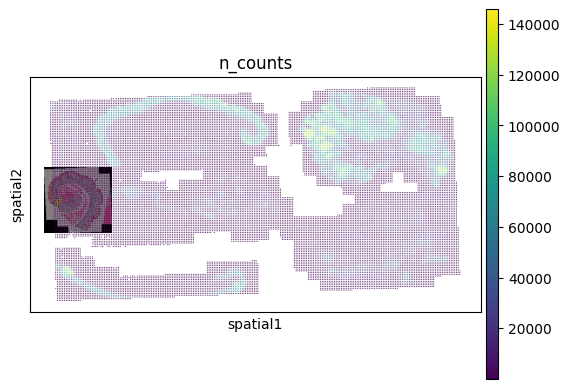

/tmp/ipykernel_4144992/3061044964.py:3: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(adata_piece, color="n_counts", img_key="downscaled_fullres")


In [ ]:
# # → dict_keys(['hires', 'lowres'])
# sc.pl.spatial(adata, color="n_counts", img_key="downscaled_fullres")
# sc.pl.spatial(adata_piece, color="n_counts", img_key="downscaled_fullres") #long wait

### Filter out unuseful variable names

In [12]:
# # Keep only variables (genes) that do not contain "Codeword"
# # Rank genes by the length of their names (string length)
# top10 = sorted(adata_piece.var_names, key=len, reverse=True)[:200]
# print(top10)
# mask = ~adata_piece.var_names.str.contains("Codeword")
# adata_piece = adata_piece[:, mask].copy()

# print(adata_piece)

# st.adata = adata_piece

AnnData object with n_obs × n_vars = 1260 × 5161
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'


### filter out cells not under HE (cell coordinate is not in HE coordinate - NOT WORK)

In [89]:
# cell_adata = st.cell_adata  # whole-slide AnnData
# cell_adata

# # 1) Get H&E pixel coords (prefer obsm['spatial']; fall back to obs['he_x','he_y'])
# x = cell_adata.obs['x_centroid'].to_numpy()
# y = cell_adata.obs['y_centroid'].to_numpy()

# # 2) Current TIF width/height (the piece you loaded via img_path)
# W = st.wsi.width
# H = st.wsi.height

# # 3) Keep only points inside the WSI rectangle (and drop NaNs)
# mask = (x >= 0) & (y >= 0) & (x < W) & (y < H) & np.isfinite(x) & np.isfinite(y)
# adata_piece = cell_adata[mask].copy()

# print("Filtered:", cell_adata.shape, "→", adata_piece.shape)

# # st.cell_adata = adata_piece

Filtered: (1074150, 5100) → (231916, 5100)


## cell_data do not seem aligned (its coordinate is different from transcript df)

In [13]:
# # 1) Sanity-check the ranges
# def r(a): 
#     return float(np.nanmin(a)), float(np.nanmax(a))

# print("spots x/y HE px:", r(st.adata.obsm["spatial"][:,0]), r(st.adata.obsm["spatial"][:,1]))
# print("cells he_x/he_y:", r(st.cell_adata.obs["he_x"].values), r(st.cell_adata.obs["he_y"].values))
# print("cells x/y centroid (Xenium space):", r(st.cell_adata.obs["x_centroid"].values), r(st.cell_adata.obs["y_centroid"].values))

spots x/y HE px: (1115.5811327974452, 8695.663176656888) (7.313984374437666, 8506.193851731994)
cells he_x/he_y: (102.27174646714154, 54176.84742647059) (23.385321673224954, 108863.70404411765)
cells x/y centroid (Xenium space): (21.732746124267578, 11512.580078125) (4.969380855560303, 23133.537109375)


/tmp/ipykernel_1277757/3614588020.py:33: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)


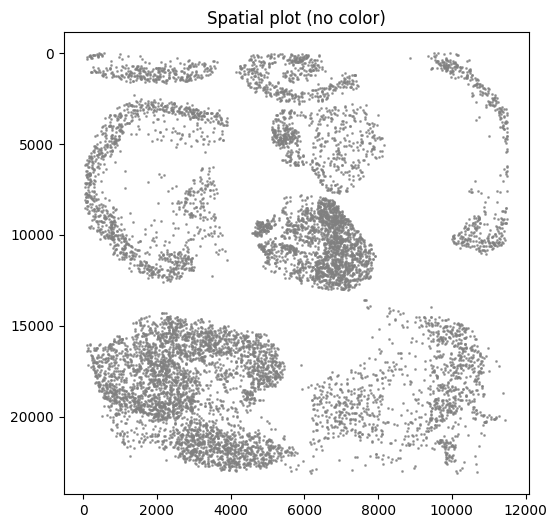

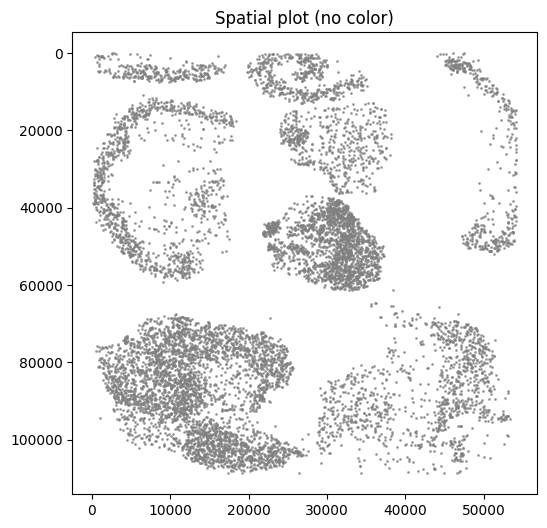

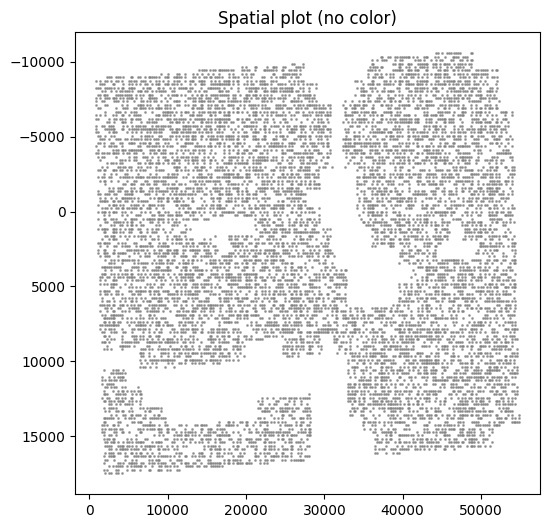

In [14]:
# cell_adata = st.cell_adata
# fast_spatial(cell_adata, x = 'x_centroid', y = 'y_centroid', spot_size=1)

# fast_spatial(cell_adata, x = 'he_x', y = 'he_y', spot_size=1)
# fast_spatial(adata, x = 'pxl_col_in_fullres', y = 'pxl_row_in_fullres', spot_size=1)
#fast_spatial(adata, x = 'array_col', y = 'array_row', spot_size=1) # super downsampled


# realign cell data

In [16]:
# # 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
# from hest.utils import read_xenium_alignment, align_xenium_df

# A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE_matrix.csv')  # 3×3
# px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# # 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
# df = st.cell_adata.obs[["x_centroid", "y_centroid"]].copy()
# df = align_xenium_df(
#     df,
#     alignment_matrix=A,
#     pixel_size_morph=px_um,
#     x_key="x_centroid",
#     y_key="y_centroid",
#     to_dapi=False,          # DAPI(µm) -> H&E
#     x_key_dist="he_x",
#     y_key_dist="he_y",
# )

# # 3) Commit back to AnnData in H&E **pixels**
# cell_adata.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
# cell_adata.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

# # 4) (Optional) clip to slide bounds to drop off-image points
# def coord_range(arr):
#     return float(np.nanmin(arr[:,0])), float(np.nanmax(arr[:,0])), \
#            float(np.nanmin(arr[:,1])), float(np.nanmax(arr[:,1]))

# # Before filtering
# x_min, x_max, y_min, y_max = coord_range(cell_adata.obsm["spatial"])
# print(f"Before filtering → x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

# # Apply filtering
# W, H = st.wsi.width, st.wsi.height
# cx, cy = cell_adata.obsm["spatial"][:,0], cell_adata.obsm["spatial"][:,1]
# keep = (cx >= 0) & (cx < W) & (cy >= 0) & (cy < H)
# cell_adata_filt = cell_adata[keep].copy()

# # After filtering
# x_min, x_max, y_min, y_max = coord_range(cell_adata_filt.obsm["spatial"])
# print(f"After filtering  → x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before filtering → x:[792.2, 54764.2], y:[-10584.5, 17434.2]
After filtering  → x:[1188.0, 8851.0], y:[3.8, 8585.0]


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [18]:
# # Single cell data to be aligned
# fname = '/project/simmons_hts/kxu/hest/xenium_labelled/XeniumPR1S1ROI1.h5ad'
# print('\n* Scanpy adata:')
# adata_labelled = sc.read_h5ad(fname)
# print(adata_labelled)
# print(adata_labelled.obs.head())     # Metadata for cells
# print(adata_labelled.var.head())     # Metadata for genes


* Scanpy adata:
AnnData object with n_obs × n_vars = 26577 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.005_210', 'predicted.id.score', 'predicted.id'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap'
            nCount_RNA  nFeature_RNA  index_safe  transcripts  \
aaknmimg-1        32.0            27  aaknmimg-1           32   
ajcikkkl-1       165.0           137  ajcikkkl-1          165   
aaiognhg-1        42.0            40  aaiognhg-1           42   
idihpaid-1        73.0            64  idihpaid-1           73   
icfpikjg-1       180.0           156  icfpikjg-1          180   

            unique_transcripts  cell_centroid_x  cell_centroid_y  cell_area  \
aaknmimg-1                  27      4836.930664      1349.580566  16.553150   
ajcikkkl-1                 137   

In [19]:
# # 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
# from hest.utils import read_xenium_alignment, align_xenium_df

# A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE_matrix.csv')  # 3×3
# px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# # 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
# df = adata_labelled.obs[["cell_centroid_x", "cell_centroid_y"]].copy()
# df = align_xenium_df(
#     df,
#     alignment_matrix=A,
#     pixel_size_morph=px_um,
#     x_key="cell_centroid_x",
#     y_key="cell_centroid_y",
#     to_dapi=False,          # DAPI(µm) -> H&E
#     x_key_dist="he_x",
#     y_key_dist="he_y",
# )

# # 3) Commit back to AnnData in H&E **pixels**
# adata_labelled.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
# adata_labelled.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

# x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
# print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")
# adata_labelled


x:[1187.2, 7341.8], y:[539.2, 8221.5]


AnnData object with n_obs × n_vars = 26577 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.005_210', 'predicted.id.score', 'predicted.id', 'he_x', 'he_y'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap', 'spatial'

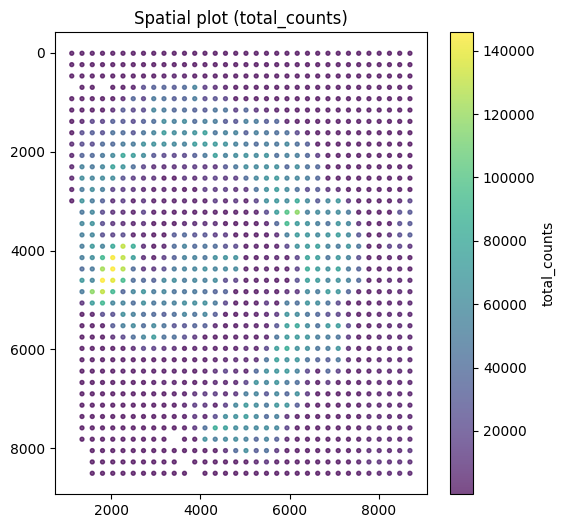

/tmp/ipykernel_1277757/3614588020.py:33: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)


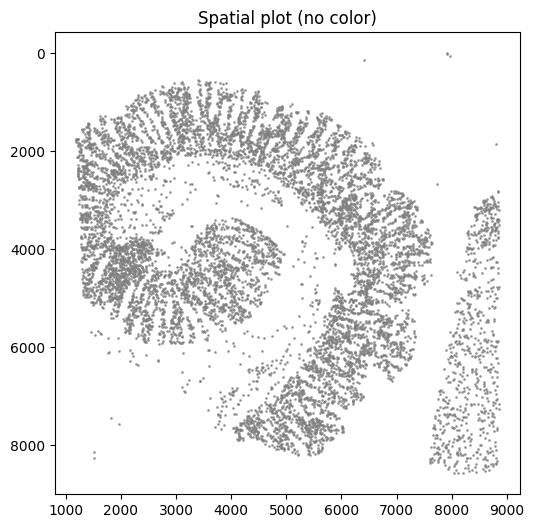

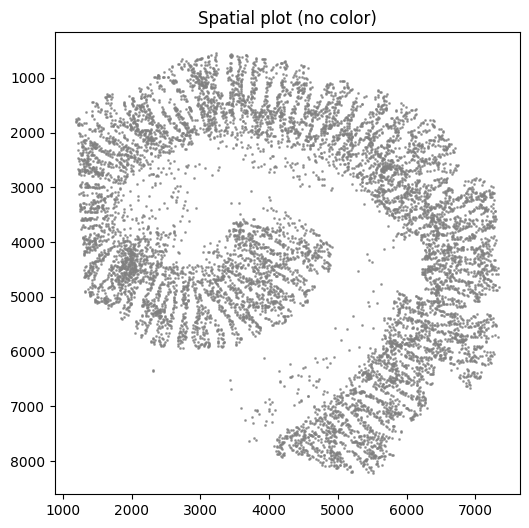

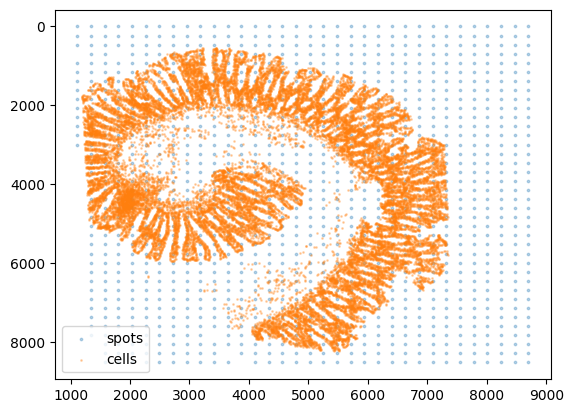

In [26]:
# # check all plots are in the ame coordinates 
# #fast_spatial(cell_adata, x = 'x_centroid', y = 'y_centroid', spot_size=1)

# # st.adata (filtered to HE area)
# fast_spatial(st.adata, x = 'pxl_col_in_fullres', y = 'pxl_row_in_fullres', color = 'total_counts', spot_size=8)

# # realigned cell adata, filtered to HE area
# fast_spatial(cell_adata_filt, x = 'he_x', y = 'he_y', spot_size=1)

# # aligned cell adata with labelled cell type, filtered to HE area 
# fast_spatial(adata_labelled, x = 'he_x', y = 'he_y', spot_size=1)

# # overlap spot and cell data 
# plt.scatter(st.adata.obsm["spatial"][:,0], st.adata.obsm["spatial"][:,1],
#             s=3, alpha=0.3, label="spots")
# plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
#             s=1, alpha=0.3, label="cells")
# plt.gca().invert_yaxis(); plt.legend(); plt.show()

In [33]:
# # --- rename columns if they exist ---
# rename_map = {
#     "cell_centroid_x": "x_centroid",
#     "cell_centroid_y": "y_centroid",
#     "index_safe":      "cell_id",        # if you want a shared ID column
#     "predicted.id":    "cell_type",      # optional: clearer name
#     'transcripts':     'transcript_counts',
#     'predicted.id.score':'cell_type_prob'
# }
# existing = {k: v for k, v in rename_map.items() if k in adata_labelled.obs.columns}
# if existing:
#     adata_labelled.obs.rename(columns=existing, inplace=True)
    
# adata_labelled.obs["segmentation_method"] = "segger"
    
# adata_labelled

AnnData object with n_obs × n_vars = 26577 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'cell_id', 'transcript_counts', 'unique_transcripts', 'x_centroid', 'y_centroid', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.005_210', 'cell_type_prob', 'cell_type', 'he_x', 'he_y', 'segmentation_method'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap', 'spatial'

### filter out spots from other samples on the edge

In [40]:
# # --- get the cell bbox in H&E px, add a safety margin ---
# cx, cy = adata_labelled.obs["he_x"].to_numpy(), adata_labelled.obs["he_y"].to_numpy()
# marg = 400  # pixels, tweak if needed
# xmin, xmax = float(np.nanmin(cx)) - marg, float(np.nanmax(cx)) + marg
# ymin, ymax = float(np.nanmin(cy)) - marg, float(np.nanmax(cy)) + marg

# # --- st.adata spots live in .obs['pxl_col_in_fullres'], .obs['pxl_row_in_fullres'] ---
# sx = st.adata.obs["pxl_col_in_fullres"].to_numpy()
# sy = st.adata.obs["pxl_row_in_fullres"].to_numpy()

# keep_spots = (sx >= xmin) & (sx <= xmax) & (sy >= ymin) & (sy <= ymax)

# # overlap spot and cell data 
# plt.scatter(st.adata[keep_spots].obsm["spatial"][:,0], st.adata[keep_spots].obsm["spatial"][:,1],
#             s=3, alpha=0.3, label="spots")
# plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
#             s=1, alpha=0.3, label="cells")
# plt.gca().invert_yaxis(); plt.legend(); plt.show()

# st.adata = st.adata[keep_spots].copy()

In [58]:
# cell_adata

AnnData object with n_obs × n_vars = 1074150 × 5100
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'he_x', 'he_y'
    var: 'gene_ids', 'feature_types', 'genome'
    obsm: 'spatial'

## edit metadata

In [63]:
# # update counts
# meta = st.meta

# # Keep a copy of old values for comparison
# old_vals = {
#     "num_cells": meta.get("num_cells"),
#     "cells_under_tissue": meta.get("cells_under_tissue"),
#     "transcripts_per_cell": meta.get("transcripts_per_cell"),
#     "total_cell_area": meta.get("total_cell_area"),
# }

# # Update with new st.cell_adata
# new_vals = {}
# new_vals["num_cells"] = st.cell_adata.n_obs
# new_vals["cells_under_tissue"] = st.cell_adata.n_obs
# new_vals["transcripts_per_cell"] = float(st.cell_adata.obs["transcript_counts"].mean())
# new_vals["total_cell_area"] = float(st.cell_adata.obs["cell_area"].sum())

# # Print before/after
# print("---- Metadata update ----")
# for k in old_vals:
#     print(f"{k}: {old_vals[k]}  -->  {new_vals.get(k)}")

# # Commit back to st.meta
# meta.update(new_vals)
# st.meta = meta

---- Metadata update ----
num_cells: 26577  -->  26577
cells_under_tissue: 26577  -->  26577
transcripts_per_cell: 115.7133988034767  -->  115.7133988034767
total_cell_area: 442995.8399666354  -->  442995.8399666354


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


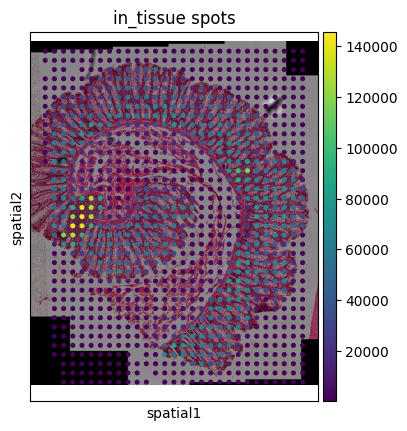

In [64]:
# save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI1")
# # # create directory (recursively) if it doesn't exist
# save_dir.mkdir(parents=True, exist_ok=True)
# st.save_spatial_plot(save_dir)
# # Warning saving a large image to pyramidal tiff (>1GB) can be slow on a hard drive.
# st.save(save_dir, pyramidal=True)

## TIP877

In [2]:
# # Base stem for experiment outputs
# exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/"
#                 "20241113__143534__SIMMONS_super_secret_prime_run1/"
#                 "output-XETG00283__0043739__Region_1__20241113__143611") 

# st = XeniumReader().read(
#     img_path="/project/simmons_hts/jpark/1_project/0_xenium/"
#              "RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE.ome.tif",
#     experiment_path=exp_stem / "experiment.xenium",
#     alignment_file_path= '/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE_matrix.csv',
#     feature_matrix_path=exp_stem / "cell_feature_matrix.h5",
#     transcripts_path=exp_stem / "transcripts.parquet",
#     cells_path=exp_stem / 'cells.parquet',
#     nucleus_bound_path=exp_stem / 'nucleus_boundaries.parquet',
#     cell_bound_path=exp_stem / 'cell_boundaries.parquet',
#     dapi_path=exp_stem / 'morphology_focus/morphology_focus_0000.ome.tif',
#     use_dask=True
# )

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [8]:
# Single cell data to be aligned
# fname = '/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI2.h5ad'
# print('\n* Scanpy adata:')
# adata_labelled = sc.read_h5ad(fname)
# print(adata_labelled)
#print(adata_labelled.obs.head())     # Metadata for cells
#print(adata_labelled.var.head())     # Metadata for genes


* Scanpy adata:
AnnData object with n_obs × n_vars = 7476 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.01_257', 'predicted.id.score', 'predicted.id'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap'


In [10]:
# adata = st.adata

# # 1) Get pixel coords on the H&E (prefer obsm['spatial'] if present)
# if 'spatial' in adata.obsm_keys():
#     xy = adata.obsm['spatial']
#     x = np.asarray(xy[:, 0])    # column (x)
#     y = np.asarray(xy[:, 1])    # row (y)
# else:
#     # fallback to Scanpy-style columns
#     x = adata.obs['pxl_col_in_fullres'].to_numpy()
#     y = adata.obs['pxl_row_in_fullres'].to_numpy()

# # 2) Get the size of THIS piece’s H&E WSI (the one you passed in img_path)
# W = st.wsi.width
# H = st.wsi.height

# # 3) Keep only points that lie inside this WSI
# mask = (x >= 0) & (y >= 0) & (x < W) & (y < H)
# adata_piece = adata[mask].copy()

# mask = ~adata_piece.var_names.str.contains("Codeword")
# adata_piece = adata_piece[:, mask].copy()

# print(adata_piece)

# st.adata = adata_piece


AnnData object with n_obs × n_vars = 879 × 5161
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'


In [13]:
# cell_adata = st.cell_adata
# # 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
# from hest.utils import read_xenium_alignment, align_xenium_df

# A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE_matrix.csv')  # 3×3
# px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# # 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
# df = st.cell_adata.obs[["x_centroid", "y_centroid"]].copy()
# df = align_xenium_df(
#     df,
#     alignment_matrix=A,
#     pixel_size_morph=px_um,
#     x_key="x_centroid",
#     y_key="y_centroid",
#     to_dapi=False,          # DAPI(µm) -> H&E
#     x_key_dist="he_x",
#     y_key_dist="he_y",
# )

# # 3) Commit back to AnnData in H&E **pixels**
# cell_adata.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
# cell_adata.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

# # 4) (Optional) clip to slide bounds to drop off-image points
# def coord_range(arr):
#     return float(np.nanmin(arr[:,0])), float(np.nanmax(arr[:,0])), \
#            float(np.nanmin(arr[:,1])), float(np.nanmax(arr[:,1]))

# # Before filtering
# x_min, x_max, y_min, y_max = coord_range(cell_adata.obsm["spatial"])
# print(f"Before filtering → x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

# # Apply filtering
# W, H = st.wsi.width, st.wsi.height
# cx, cy = cell_adata.obsm["spatial"][:,0], cell_adata.obsm["spatial"][:,1]
# keep = (cx >= 0) & (cx < W) & (cy >= 0) & (cy < H)
# cell_adata_filt = cell_adata[keep].copy()

# # After filtering
# x_min, x_max, y_min, y_max = coord_range(cell_adata_filt.obsm["spatial"])
# print(f"After filtering  → x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before filtering → x:[2142.4, 56055.3], y:[-36.7, 27910.1]
After filtering  → x:[2142.4, 7313.8], y:[1626.3, 10414.7]


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [46]:
# # 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
# from hest.utils import read_xenium_alignment, align_xenium_df

# A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP877_Xenium5K_post_HnE_matrix.csv')  # 3×3
# px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# # 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
# df = adata_labelled.obs[["cell_centroid_x", "cell_centroid_y"]].copy()
# df = align_xenium_df(
#     df,
#     alignment_matrix=A,
#     pixel_size_morph=px_um,
#     x_key="cell_centroid_x",
#     y_key="cell_centroid_y",
#     to_dapi=False,          # DAPI(µm) -> H&E
#     x_key_dist="he_x",
#     y_key_dist="he_y",
# )

# # 3) Commit back to AnnData in H&E **pixels**
# adata_labelled.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
# adata_labelled.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

# x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
# print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")


# # --- rename columns if they exist ---
# rename_map = {
#     "cell_centroid_x": "x_centroid",
#     "cell_centroid_y": "y_centroid",
#     "index_safe":      "cell_id",        # if you want a shared ID column
#     "predicted.id":    "cell_type",      # optional: clearer name
#     'transcripts':     'transcript_counts',
#     'predicted.id.score':'cell_type_prob'
# }
# existing = {k: v for k, v in rename_map.items() if k in adata_labelled.obs.columns}
# if existing:
#     adata_labelled.obs.rename(columns=existing, inplace=True)
    
# adata_labelled.obs["segmentation_method"] = "segger"

KeyError: "None of [Index(['cell_centroid_x', 'cell_centroid_y'], dtype='object')] are in the [columns]"

In [47]:
# st.cell_adata = adata_labelled

In [49]:
# # update counts
# meta = st.meta

# # Keep a copy of old values for comparison
# old_vals = {
#     "num_cells": meta.get("num_cells"),
#     "cells_under_tissue": meta.get("cells_under_tissue"),
#     "transcripts_per_cell": meta.get("transcripts_per_cell"),
#     "total_cell_area": meta.get("total_cell_area"),
# }

# # Update with new st.cell_adata
# new_vals = {}
# new_vals["num_cells"] = st.cell_adata.n_obs
# new_vals["cells_under_tissue"] = st.cell_adata.n_obs
# new_vals["transcripts_per_cell"] = float(st.cell_adata.obs["transcript_counts"].mean())
# new_vals["total_cell_area"] = float(st.cell_adata.obs["cell_area"].sum())

# # Print before/after
# print("---- Metadata update ----")
# for k in old_vals:
#     print(f"{k}: {old_vals[k]}  -->  {new_vals.get(k)}")

# # Commit back to st.meta
# meta.update(new_vals)
# st.meta = meta

---- Metadata update ----
num_cells: 1074150  -->  7476
cells_under_tissue: 1074150  -->  7476
transcripts_per_cell: 228.9685891169762  -->  71.56861958266452
total_cell_area: 55846944.49765815  -->  116343.38721884842


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


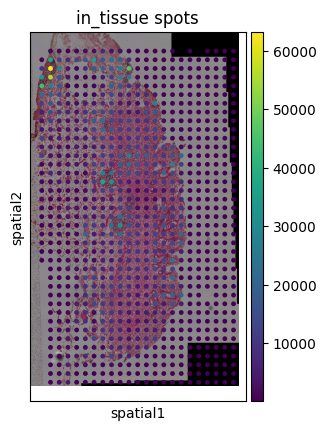

In [50]:
# save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI2")
# # # create directory (recursively) if it doesn't exist
# save_dir.mkdir(parents=True, exist_ok=True)
# st.save_spatial_plot(save_dir)
# st.save(save_dir, pyramidal=True)

In [59]:
# plot_cell(
#     st_adata=st.adata,
#     adata_labelled=st.cell_adata,
#     save_dir=save_dir
# )

/tmp/ipykernel_3454450/1227968361.py:49: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay plot saved to: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI2/cell_plot.png


PosixPath('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI2/cell_plot.png')

# XeniumPR1S1ROI1 (re-processed)

In [3]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/CAM006_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


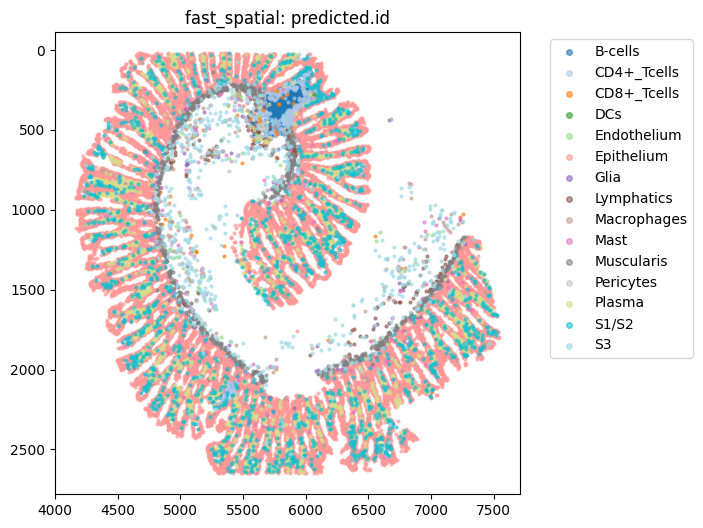

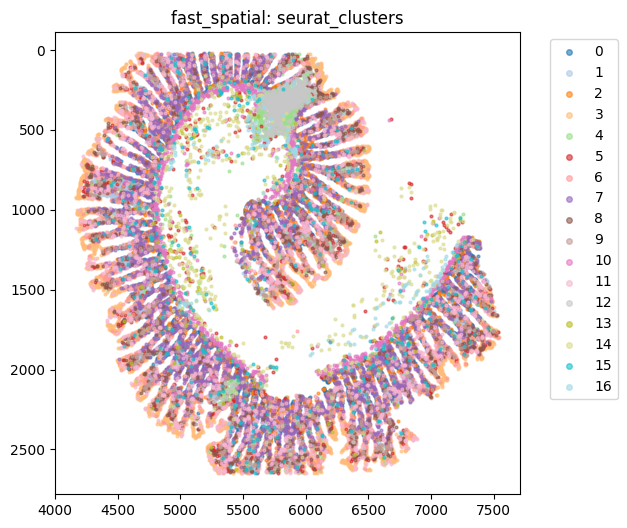

NameError: name 'st' is not defined

In [2]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [4]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI1.h5ad")
adata_labelled

AnnData object with n_obs × n_vars = 26577 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.005_210', 'predicted.id.score', 'predicted.id'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap'

In [5]:
import anndata as ad
import pandas as pd
import numpy as np

def inspect_xenium_h5ad_coords(h5ad_path, sample=3):
    """
    Inspect an AnnData .h5ad file to infer where transcript or spatial coordinates are stored.
    """
    print(f"📂 Reading: {h5ad_path}")
    adata = ad.read_h5ad(h5ad_path)
    print(f"AnnData: {adata.n_obs} obs × {adata.n_vars} vars\n")

    found = False

    # --- 1. Check .obs for coordinates ---
    obs_cols = set(adata.obs.columns)
    coord_candidates = [c for c in obs_cols if any(k in c.lower() for k in ["x", "y", "coord", "loc"])]
    if coord_candidates:
        found = True
        print("🧭 Possible coordinate-related columns in .obs:")
        for c in coord_candidates:
            print(f"   • {c}  (example: {adata.obs[c].iloc[:sample].tolist()})")

    # --- 2. Check if obs['transcripts'] exists ---
    if "transcripts" in adata.obs.columns:
        print("\n🧬 Found 'transcripts' column in .obs.")
        example = adata.obs["transcripts"].iloc[0]
        print("   Example entry type:", type(example))
        if isinstance(example, str):
            print("   Looks like a string (maybe JSON?)")
            print("   Preview:", str(example)[:300])
        elif isinstance(example, (list, tuple)):
            print(f"   Contains {len(example)} items. First few:", example[:sample])
        elif isinstance(example, dict):
            print(f"   Keys: {list(example.keys())}")
        else:
            print("   Unrecognized format — try json.loads or ast.literal_eval on it.")
        found = True

    # --- 3. Check .uns for molecule tables ---
    for key, val in adata.uns.items():
        if isinstance(val, (pd.DataFrame, dict, np.ndarray)):
            cols = []
            if isinstance(val, pd.DataFrame):
                cols = list(val.columns)
            elif isinstance(val, dict):
                cols = list(val.keys())
            if any(k in str(cols).lower() for k in ["x", "y", "coord", "loc"]):
                print(f"\n🧫 Found coordinate-like data in adata.uns['{key}']")
                if isinstance(val, pd.DataFrame):
                    print(val.head(sample))
                elif isinstance(val, dict):
                    for subk in list(val.keys())[:sample]:
                        print(f"   {subk}: type={type(val[subk])}")
                found = True

    # --- 4. Check .layers for molecule tables ---
    for key, val in adata.layers.items():
        if isinstance(val, np.ndarray):
            print(f"\n🧪 Found array in adata.layers['{key}'] with shape {val.shape}")
            found = True

    # --- 5. Check .obsm for spatial coordinates ---
    for key, val in adata.obsm.items():
        if isinstance(val, np.ndarray) and val.shape[1] in (2, 3):
            print(f"\n📍 Found {val.shape[1]}-D spatial coordinates in adata.obsm['{key}']")
            print(f"   First {sample} rows:\n", val[:sample])
            found = True

    if not found:
        print("❌ No obvious coordinate or transcript table found — may be stored externally or nested.")

# Example usage:
inspect_xenium_h5ad_coords("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI1.h5ad")


📂 Reading: /project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI1.h5ad
AnnData: 26577 obs × 5121 vars

🧭 Possible coordinate-related columns in .obs:
   • index_safe  (example: ['aaknmimg-1', 'ajcikkkl-1', 'aaiognhg-1'])
   • cell_centroid_x  (example: [4836.9306640625, 5826.7802734375, 5202.53759765625])
   • cell_centroid_y  (example: [1349.58056640625, 412.25775146484375, 1858.6666259765625])

🧬 Found 'transcripts' column in .obs.
   Example entry type: <class 'numpy.int32'>
   Unrecognized format — try json.loads or ast.literal_eval on it.

📍 Found 2-D spatial coordinates in adata.obsm['X_umap']
   First 3 rows:
 [[-9.14803219 -2.95643772]
 [ 3.24141669  6.18273149]
 [-2.13203025  0.1093279 ]]


Spots kept after rules: 1094 / 1260


/tmp/ipykernel_3989039/1522164877.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


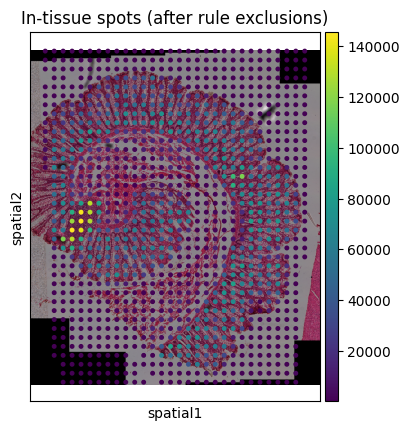

In [14]:
# --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.10, "units": "frac"},
    {'type':'corner', 'corner':'bottom-right', 'width':0.13, 'height':0.38, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [ ]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

Before/After: {'old': {'num_cells': 26577, 'cells_under_tissue': 26577, 'transcripts_per_cell': 115.7133988034767, 'total_cell_area': 442995.8399666354}, 'new': {'num_cells': 26577, 'cells_under_tissue': 26577, 'transcripts_per_cell': 115.7133988034767, 'total_cell_area': 442995.8399666354}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


# XeniumPR1S1ROI3

In [3]:
# Base stem for experiment outputs
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/"
                "20241113__143534__SIMMONS_super_secret_prime_run1/"
                "output-XETG00283__0043739__Region_1__20241113__143611") 

st = XeniumReader().read(
    img_path="/project/simmons_hts/jpark/1_project/0_xenium/"
             "RUNTRexBio/post_HnE/GI9389_Xenium5K_post_HnE.ome.tif",
    experiment_path=exp_stem / "experiment.xenium",
    alignment_file_path= '/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9389_Xenium5K_post_HnE_matrix.csv',
    feature_matrix_path=exp_stem / "cell_feature_matrix.h5",
    transcripts_path=exp_stem / "transcripts.parquet",
    cells_path=exp_stem / 'cells.parquet',
    nucleus_bound_path=exp_stem / 'nucleus_boundaries.parquet',
    cell_bound_path=exp_stem / 'cell_boundaries.parquet',
    dapi_path=exp_stem / 'morphology_focus/morphology_focus_0000.ome.tif',
    use_dask=True
)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [8]:
# Single cell data to be aligned
fname = '/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI3.h5ad'
adata_labelled = sc.read_h5ad(fname)
print(adata_labelled)
fast_spatial(adata_labelled, x = 'cell_centroid_x', y = 'cell_centroid_y', spot_size=1)

AnnData object with n_obs × n_vars = 7375 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.04_1896', 'predicted.id.score', 'predicted.id'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap'


/tmp/ipykernel_197246/3772035162.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)


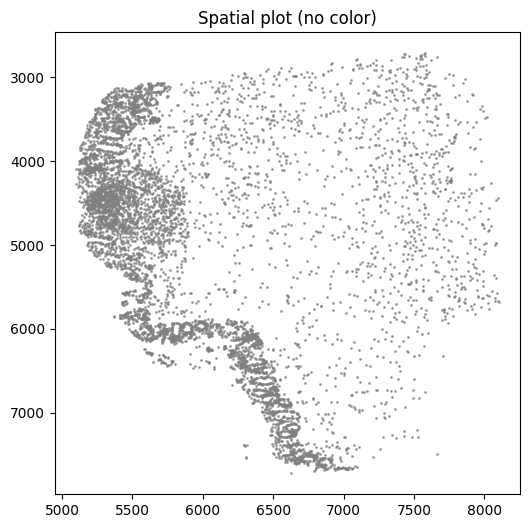

In [9]:
fast_spatial(adata_labelled, x = 'cell_centroid_x', y = 'cell_centroid_y', spot_size=1)
# Make sure your coordinates are in obsm
adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x", "cell_centroid_y"]].to_numpy()

In [10]:
adata = st.adata

# 1) Get pixel coords on the H&E (prefer obsm['spatial'] if present)
if 'spatial' in adata.obsm_keys():
    xy = adata.obsm['spatial']
    x = np.asarray(xy[:, 0])    # column (x)
    y = np.asarray(xy[:, 1])    # row (y)
else:
    # fallback to Scanpy-style columns
    x = adata.obs['pxl_col_in_fullres'].to_numpy()
    y = adata.obs['pxl_row_in_fullres'].to_numpy()

# 2) Get the size of THIS piece’s H&E WSI (the one you passed in img_path)
W = st.wsi.width
H = st.wsi.height

# 3) Keep only points that lie inside this WSI
mask = (x >= 0) & (y >= 0) & (x < W) & (y < H)
adata_piece = adata[mask].copy()

mask = ~adata_piece.var_names.str.contains("Codeword")
adata_piece = adata_piece[:, mask].copy()

print(adata_piece)

st.adata = adata_piece

AnnData object with n_obs × n_vars = 2084 × 5161
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [13]:
# 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
from hest.utils import read_xenium_alignment, align_xenium_df

A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9389_Xenium5K_post_HnE_matrix.csv')  # 3×3
px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
df = adata_labelled.obs[["cell_centroid_x", "cell_centroid_y"]].copy()
df = align_xenium_df(
    df,
    alignment_matrix=A,
    pixel_size_morph=px_um,
    x_key="cell_centroid_x",
    y_key="cell_centroid_y",
    to_dapi=False,          # DAPI(µm) -> H&E
    x_key_dist="he_x",
    y_key_dist="he_y",
)

# 3) Commit back to AnnData in H&E **pixels**
adata_labelled.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
adata_labelled.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")


# --- rename columns if they exist ---
rename_map = {
    "cell_centroid_x": "x_centroid",
    "cell_centroid_y": "y_centroid",
    "index_safe":      "cell_id",        # if you want a shared ID column
    "predicted.id":    "cell_type",      # optional: clearer name
    'transcripts':     'transcript_counts',
    'predicted.id.score':'cell_type_prob'
}
existing = {k: v for k, v in rename_map.items() if k in adata_labelled.obs.columns}
if existing:
    adata_labelled.obs.rename(columns=existing, inplace=True)
    
adata_labelled.obs["segmentation_method"] = "segger"

st.cell_adata = adata_labelled

x:[760.1, 12207.8], y:[945.6, 7827.1]


### filter out spots outside this sample on the edge of H&E 

In [14]:
#st.adata = adata_piece

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


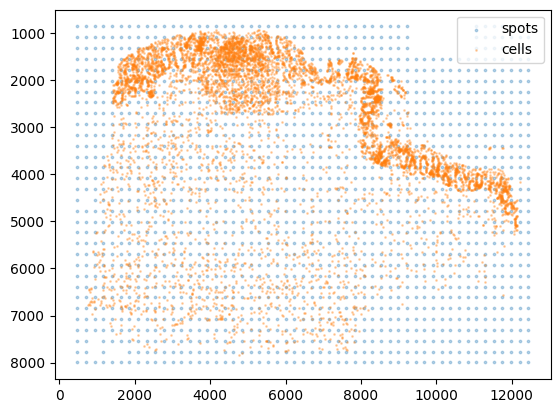

In [15]:
# --- get the cell bbox in H&E px, add a safety margin ---
cx, cy = adata_labelled.obs["he_x"].to_numpy(), adata_labelled.obs["he_y"].to_numpy()
marg = 300  # pixels, tweak if needed
xmin, xmax = float(np.nanmin(cx)) - marg, float(np.nanmax(cx)) + marg
ymin, ymax = float(np.nanmin(cy)) - marg, float(np.nanmax(cy)) + marg

# --- st.adata spots live in .obs['pxl_col_in_fullres'], .obs['pxl_row_in_fullres'] ---
sx = st.adata.obs["pxl_col_in_fullres"].to_numpy()
sy = st.adata.obs["pxl_row_in_fullres"].to_numpy()

keep_spots = (sx >= xmin) & (sx <= xmax) & (sy >= ymin) & (sy <= ymax)

# overlap spot and cell data 
plt.scatter(st.adata[keep_spots].obsm["spatial"][:,0], st.adata[keep_spots].obsm["spatial"][:,1],
            s=3, alpha=0.3, label="spots")
plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
            s=1, alpha=0.3, label="cells")
plt.gca().invert_yaxis(); plt.legend(); plt.show()

#st.adata = st.adata[keep_spots].copy()

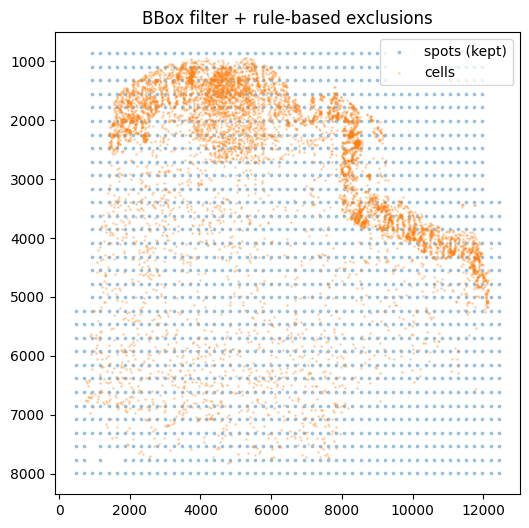

/tmp/ipykernel_197246/1249698531.py:110: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")


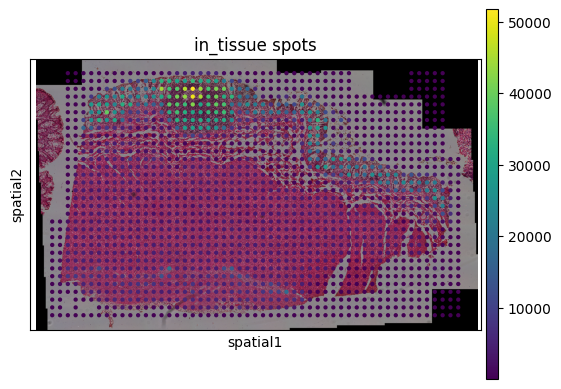

In [ ]:
# ---------------- rule-based exclusions ----------------
def apply_spot_exclusions(sx, sy, bbox, rules):
    """
    Exclude spots by region rules. Returns a boolean mask of spots to KEEP.
    
    Parameters
    ----------
    sx, sy : 1D arrays of spot coordinates (pixels)
    bbox   : (xmin, xmax, ymin, ymax) in pixels
    rules  : list of dicts. Supported types:
      - {'type':'corner', 'corner':'top-left|top-right|bottom-left|bottom-right',
         'width': <float>, 'height': <float>, 'units':'px'|'frac'}
      - {'type':'strip', 'side':'top|bottom|left|right', 'size': <float>, 'units':'px'|'frac'}
      - {'type':'rect', 'xmin': <float>, 'xmax': <float>, 'ymin': <float>, 'ymax': <float>, 'units':'px'|'frac'}
        * For 'rect' in 'frac' units, values are in [0,1] relative to the bbox (0=left/top, 1=right/bottom).
    """
    xmin, xmax, ymin, ymax = bbox
    w = xmax - xmin
    h = ymax - ymin

    exclude = np.zeros_like(sx, dtype=bool)

    for r in rules:
        rtype = r.get('type')

        if rtype == 'corner':
            units = r.get('units', 'px')
            corner = r['corner']
            ww = r['width']
            hh = r['height']
            if units == 'frac':
                ww = ww * w
                hh = hh * h

            if corner == 'top-left':
                cond = (sx < xmin + ww) & (sy < ymin + hh)
            elif corner == 'top-right':
                cond = (sx > xmax - ww) & (sy < ymin + hh)
            elif corner == 'bottom-left':
                cond = (sx < xmin + ww) & (sy > ymax - hh)
            elif corner == 'bottom-right':
                cond = (sx > xmax - ww) & (sy > ymax - hh)
            else:
                raise ValueError("corner must be one of: top-left, top-right, bottom-left, bottom-right")
            exclude |= cond

        elif rtype == 'strip':
            units = r.get('units', 'px')
            side = r['side']
            ss = r['size']
            if units == 'frac':
                ss = ss * (h if side in ('top','bottom') else w)

            if side == 'top':
                cond = sy < ymin + ss
            elif side == 'bottom':
                cond = sy > ymax - ss
            elif side == 'left':
                cond = sx < xmin + ss
            elif side == 'right':
                cond = sx > xmax - ss
            else:
                raise ValueError("side must be one of: top, bottom, left, right")
            exclude |= cond

        elif rtype == 'rect':
            units = r.get('units', 'px')
            if units == 'frac':
                rxmin = xmin + r['xmin'] * w
                rxmax = xmin + r['xmax'] * w
                rymin = ymin + r['ymin'] * h
                rymax = ymin + r['ymax'] * h
            else:
                rxmin, rxmax = r['xmin'], r['xmax']
                rymin, rymax = r['ymin'], r['ymax']
            cond = (sx >= rxmin) & (sx <= rxmax) & (sy >= rymin) & (sy <= rymax)
            exclude |= cond

        else:
            raise ValueError(f"Unknown rule type: {rtype}")

    return ~exclude  # keep mask

# ---- Example: omit the top-left corner (10% width × 15% height of the bbox) ----
rules = [
    {'type':'corner', 'corner':'top-left', 'width':0.03, 'height':0.6, 'units':'frac'},
    {'type':'corner', 'corner':'top-right', 'width':0.04, 'height':0.35, 'units':'frac'}
]

# (You can stack rules; e.g., also drop a 50 px strip at the bottom)
# rules.append({'type':'strip', 'side':'bottom', 'size':50, 'units':'px'})

keep_after_rules = apply_spot_exclusions(sx[keep_spots], sy[keep_spots], (xmin, xmax, ymin, ymax), rules)

# Merge with the original bbox filter
final_keep = keep_spots.copy()
final_keep[keep_spots] &= keep_after_rules

# ---- visualize & apply ----
plt.figure(figsize=(6,6))
plt.scatter(st.adata.obsm["spatial"][final_keep, 0], st.adata.obsm["spatial"][final_keep, 1],
            s=3, alpha=0.35, label="spots (kept)")
plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
            s=1, alpha=0.25, label="cells")
plt.gca().invert_yaxis()
plt.legend()
plt.title("BBox filter + rule-based exclusions")
plt.show()

sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")

/tmp/ipykernel_197246/1908858772.py:1: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")


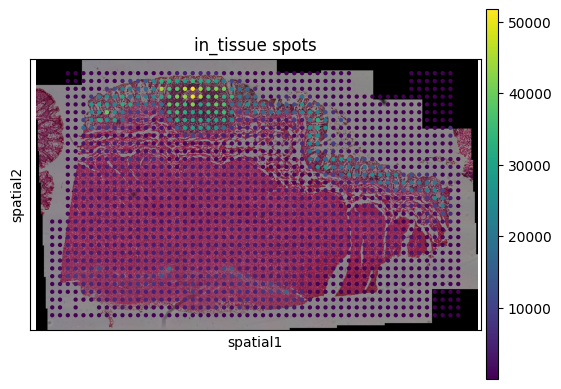

In [ ]:
sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")

In [19]:
st.adata = st.adata[final_keep]

In [20]:
# update counts
meta = st.meta

# Keep a copy of old values for comparison
old_vals = {
    "num_cells": meta.get("num_cells"),
    "cells_under_tissue": meta.get("cells_under_tissue"),
    "transcripts_per_cell": meta.get("transcripts_per_cell"),
    "total_cell_area": meta.get("total_cell_area"),
}

# Update with new st.cell_adata
new_vals = {}
new_vals["num_cells"] = st.cell_adata.n_obs
new_vals["cells_under_tissue"] = st.cell_adata.n_obs
new_vals["transcripts_per_cell"] = float(st.cell_adata.obs["transcript_counts"].mean())
new_vals["total_cell_area"] = float(st.cell_adata.obs["cell_area"].sum())

# Print before/after
print("---- Metadata update ----")
for k in old_vals:
    print(f"{k}: {old_vals[k]}  -->  {new_vals.get(k)}")

# Commit back to st.meta
meta.update(new_vals)
st.meta = meta

---- Metadata update ----
num_cells: 1074150  -->  7375
cells_under_tissue: 1074150  -->  7375
transcripts_per_cell: 156  -->  66.00881355932204
total_cell_area: 55846944.49765815  -->  118138.61459176126


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/tmp/ipykernel_197246/3772035162.py:49: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay plot saved to: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI3/cell_plot.png


PosixPath('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI3/cell_plot.png')

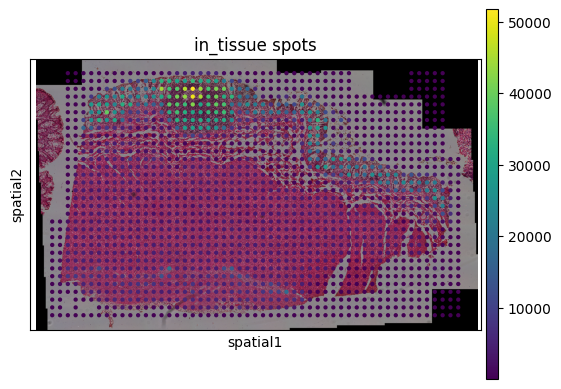

In [ ]:
save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI3")
# # create directory (recursively) if it doesn't exist
save_dir.mkdir(parents=True, exist_ok=True)
st.save_spatial_plot(save_dir)
st.save(save_dir, pyramidal=True)
plot_cell(
    st_adata=st.adata,
    adata_labelled=st.cell_adata,
    save_dir=save_dir
)

# XeniumPR1S1ROI4

In [22]:
# Base stem for experiment outputs
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/"
                "20241113__143534__SIMMONS_super_secret_prime_run1/"
                "output-XETG00283__0043739__Region_1__20241113__143611") 

st = XeniumReader().read(
    img_path="/project/simmons_hts/jpark/1_project/0_xenium/"
             "RUNTRexBio/post_HnE/GI9077_Xenium5K_post_HnE.ome.tif",
    experiment_path=exp_stem / "experiment.xenium",
    alignment_file_path= '/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9077_Xenium5K_post_HnE_matrix.csv',
    feature_matrix_path=exp_stem / "cell_feature_matrix.h5",
    transcripts_path=exp_stem / "transcripts.parquet",
    cells_path=exp_stem / 'cells.parquet',
    nucleus_bound_path=exp_stem / 'nucleus_boundaries.parquet',
    cell_bound_path=exp_stem / 'cell_boundaries.parquet',
    dapi_path=exp_stem / 'morphology_focus/morphology_focus_0000.ome.tif',
    use_dask=True
)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


AnnData object with n_obs × n_vars = 8507 × 5121
    obs: 'nCount_RNA', 'nFeature_RNA', 'index_safe', 'transcripts', 'unique_transcripts', 'cell_centroid_x', 'cell_centroid_y', 'cell_area', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.7', 'seurat_clusters', 'pANN_0.25_0.03_4183', 'predicted.id.score', 'predicted.id'
    var: 'gene', 'total_assigned', 'total_unassigned'
    obsm: 'X_pca', 'X_umap'


/tmp/ipykernel_197246/3772035162.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)


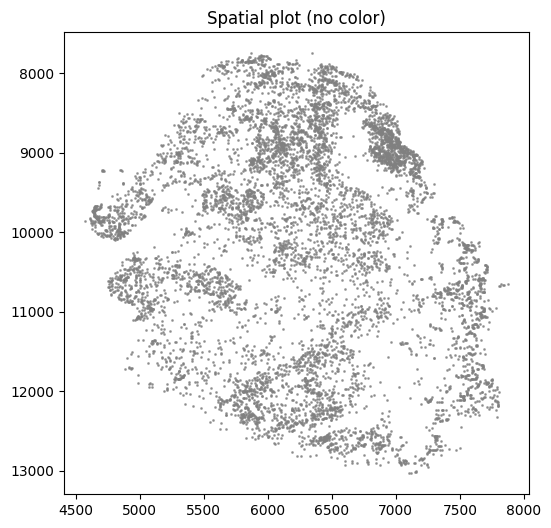

In [23]:
# Single cell data to be aligned
fname = '/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI4.h5ad'
adata_labelled = sc.read_h5ad(fname)
print(adata_labelled)
fast_spatial(adata_labelled, x = 'cell_centroid_x', y = 'cell_centroid_y', spot_size=1)

In [24]:
adata = st.adata

# 1) Get pixel coords on the H&E (prefer obsm['spatial'] if present)
if 'spatial' in adata.obsm_keys():
    xy = adata.obsm['spatial']
    x = np.asarray(xy[:, 0])    # column (x)
    y = np.asarray(xy[:, 1])    # row (y)
else:
    # fallback to Scanpy-style columns
    x = adata.obs['pxl_col_in_fullres'].to_numpy()
    y = adata.obs['pxl_row_in_fullres'].to_numpy()

# 2) Get the size of THIS piece’s H&E WSI (the one you passed in img_path)
W = st.wsi.width
H = st.wsi.height

# 3) Keep only points that lie inside this WSI
mask = (x >= 0) & (y >= 0) & (x < W) & (y < H)
adata_piece = adata[mask].copy()

mask = ~adata_piece.var_names.str.contains("Codeword")
adata_piece = adata_piece[:, mask].copy()

print(adata_piece)

st.adata = adata_piece

AnnData object with n_obs × n_vars = 2141 × 5161
    obs: 'in_tissue', 'pxl_col_in_fullres', 'pxl_row_in_fullres', 'array_col', 'array_row', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [25]:
# 1) Load the 3×3 affine and pixel size (µm/px of the DAPI/morph image)
from hest.utils import read_xenium_alignment, align_xenium_df

A = read_xenium_alignment('/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9077_Xenium5K_post_HnE_matrix.csv')  # 3×3
px_um = st.meta["pixel_size"]  # if you stored it; otherwise pass the value you used

# 2) Apply the transform to cells (inputs must be DAPI-frame coordinates in µm)
df = adata_labelled.obs[["cell_centroid_x", "cell_centroid_y"]].copy()
df = align_xenium_df(
    df,
    alignment_matrix=A,
    pixel_size_morph=px_um,
    x_key="cell_centroid_x",
    y_key="cell_centroid_y",
    to_dapi=False,          # DAPI(µm) -> H&E
    x_key_dist="he_x",
    y_key_dist="he_y",
)

# 3) Commit back to AnnData in H&E **pixels**
adata_labelled.obs[["he_x", "he_y"]] = df[["he_x", "he_y"]]
adata_labelled.obsm["spatial"] = df[["he_x", "he_y"]].to_numpy()

x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")


# --- rename columns if they exist ---
rename_map = {
    "cell_centroid_x": "x_centroid",
    "cell_centroid_y": "y_centroid",
    "index_safe":      "cell_id",        # if you want a shared ID column
    "predicted.id":    "cell_type",      # optional: clearer name
    'transcripts':     'transcript_counts',
    'predicted.id.score':'cell_type_prob'
}
existing = {k: v for k, v in rename_map.items() if k in adata_labelled.obs.columns}
if existing:
    adata_labelled.obs.rename(columns=existing, inplace=True)
    
adata_labelled.obs["segmentation_method"] = "segger"

st.cell_adata = adata_labelled

x:[898.0, 13133.0], y:[781.0, 8291.2]


In [26]:
# update counts
meta = st.meta

# Keep a copy of old values for comparison
old_vals = {
    "num_cells": meta.get("num_cells"),
    "cells_under_tissue": meta.get("cells_under_tissue"),
    "transcripts_per_cell": meta.get("transcripts_per_cell"),
    "total_cell_area": meta.get("total_cell_area"),
}

# Update with new st.cell_adata
new_vals = {}
new_vals["num_cells"] = st.cell_adata.n_obs
new_vals["cells_under_tissue"] = st.cell_adata.n_obs
new_vals["transcripts_per_cell"] = float(st.cell_adata.obs["transcript_counts"].mean())
new_vals["total_cell_area"] = float(st.cell_adata.obs["cell_area"].sum())

# Print before/after
print("---- Metadata update ----")
for k in old_vals:
    print(f"{k}: {old_vals[k]}  -->  {new_vals.get(k)}")

# Commit back to st.meta
meta.update(new_vals)
st.meta = meta

---- Metadata update ----
num_cells: 1074150  -->  8507
cells_under_tissue: 1074150  -->  8507
transcripts_per_cell: 156  -->  45.89491007405666
total_cell_area: 55846944.49765815  -->  130238.31756915661


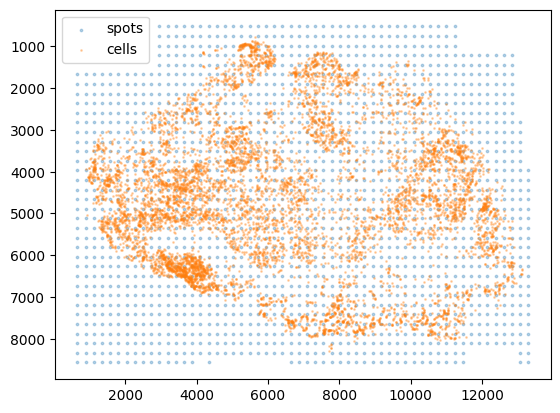

/tmp/ipykernel_197246/2737922561.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(st.adata[keep_spots],img_key="downscaled_fullres", color = 'log1p_total_counts',title=f"in_tissue spots")


In [ ]:
# --- get the cell bbox in H&E px, add a safety margin ---
cx, cy = adata_labelled.obs["he_x"].to_numpy(), adata_labelled.obs["he_y"].to_numpy()
marg = 300  # pixels, tweak if needed
xmin, xmax = float(np.nanmin(cx)) - marg, float(np.nanmax(cx)) + marg
ymin, ymax = float(np.nanmin(cy)) - marg, float(np.nanmax(cy)) + marg

# --- st.adata spots live in .obs['pxl_col_in_fullres'], .obs['pxl_row_in_fullres'] ---
sx = st.adata.obs["pxl_col_in_fullres"].to_numpy()
sy = st.adata.obs["pxl_row_in_fullres"].to_numpy()

keep_spots = (sx >= xmin) & (sx <= xmax) & (sy >= ymin) & (sy <= ymax)

# overlap spot and cell data 
plt.scatter(st.adata[keep_spots].obsm["spatial"][:,0], st.adata[keep_spots].obsm["spatial"][:,1],
            s=3, alpha=0.3, label="spots")
plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
            s=1, alpha=0.3, label="cells")
plt.gca().invert_yaxis(); plt.legend(); plt.show()

sc.pl.spatial(st.adata[keep_spots],img_key="downscaled_fullres", color = 'log1p_total_counts',title=f"in_tissue spots")

#st.adata = st.adata[keep_spots].copy()

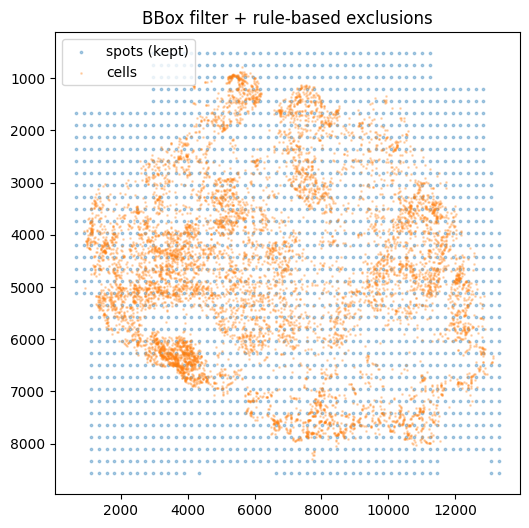

/tmp/ipykernel_197246/1173409031.py:27: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")


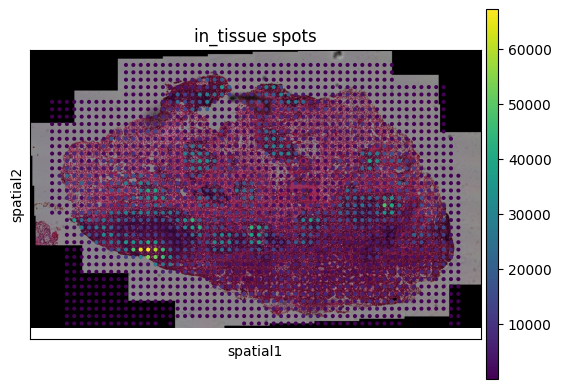

In [36]:
# ---- Example: omit the top-left corner (10% width × 15% height of the bbox) ----
rules = [
    {'type':'corner', 'corner':'bottom-left', 'width':0.03, 'height':0.4, 'units':'frac'},
]

# (You can stack rules; e.g., also drop a 50 px strip at the bottom)
# rules.append({'type':'strip', 'side':'bottom', 'size':50, 'units':'px'})

keep_after_rules = apply_spot_exclusions(sx[keep_spots], sy[keep_spots], (xmin, xmax, ymin, ymax), rules)

# Merge with the original bbox filter
final_keep = keep_spots.copy()
final_keep[keep_spots] &= keep_after_rules

# ---- visualize & apply ----
plt.figure(figsize=(6,6))
plt.scatter(st.adata.obsm["spatial"][final_keep, 0], st.adata.obsm["spatial"][final_keep, 1],
            s=3, alpha=0.35, label="spots (kept)")
plt.scatter(adata_labelled.obsm["spatial"][:,0], adata_labelled.obsm["spatial"][:,1],
            s=1, alpha=0.25, label="cells")
plt.gca().invert_yaxis()
plt.legend()
plt.title("BBox filter + rule-based exclusions")
plt.show()

sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")

In [ ]:
sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'log1p_total_counts',title=f"in_tissue spots")

/tmp/ipykernel_197246/3810608294.py:1: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(st.adata[final_keep],img_key="downscaled_fullres", color = 'log1p_total_counts',title=f"in_tissue spots")


In [37]:
st.adata = st.adata[final_keep]

/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/tmp/ipykernel_197246/3772035162.py:49: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay plot saved to: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI4/cell_plot.png


PosixPath('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI4/cell_plot.png')

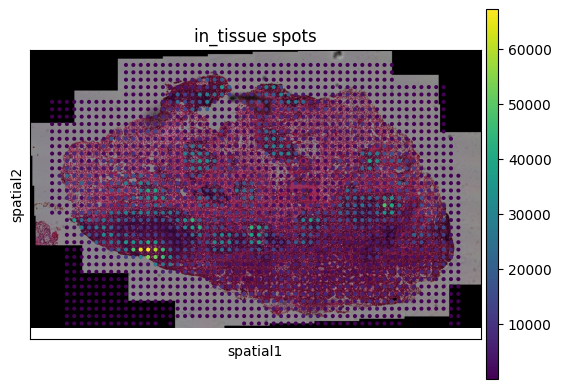

In [38]:
save_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI4")
# # create directory (recursively) if it doesn't exist
save_dir.mkdir(parents=True, exist_ok=True)
st.save_spatial_plot(save_dir)
st.save(save_dir, pyramidal=True)
plot_cell(
    st_adata=st.adata,
    adata_labelled=st.cell_adata,
    save_dir=save_dir
)

# XeniumPR1S1ROI5

In [5]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9612_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9612_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [16]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI5.h5ad")

In [17]:
# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [18]:
# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_290225/3772035162.py:88: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sc = plt.scatter(x_vals, y_vals, s=spot_size, c=c, cmap=cmap, alpha=0.7)


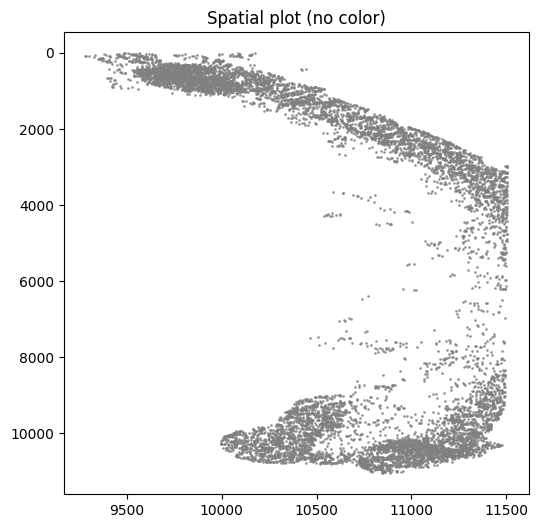

In [20]:
# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, x = 'x_centroid', y = 'y_centroid', spot_size=1)

In [21]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

In [22]:
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

Before/After: {'old': {'num_cells': 14513, 'cells_under_tissue': 14513, 'transcripts_per_cell': 97.5835457865362, 'total_cell_area': 242351.12138931203}, 'new': {'num_cells': 21691, 'cells_under_tissue': 21691, 'transcripts_per_cell': 137.38522889677748, 'total_cell_area': 366730.7105503036}}


In [23]:
# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

x:[3086.3, 28621.2], y:[992.3, 5904.2]


In [24]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI5")
out_dir.mkdir(parents=True, exist_ok=True)

plot_cell(st.adata, adata_labelled, out_dir)

/tmp/ipykernel_290225/3772035162.py:49: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay plot saved to: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI5/cell_plot.png


PosixPath('/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI5/cell_plot.png')

/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:243: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI5/cell_plot.png


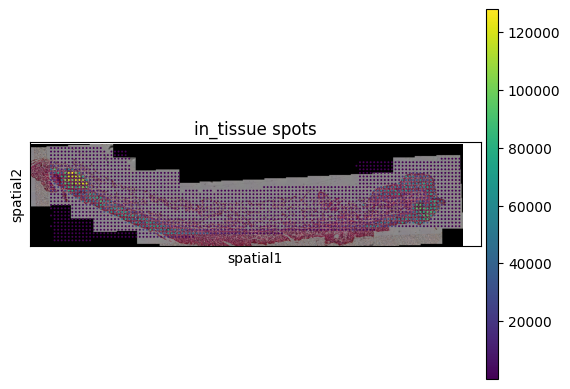

In [25]:
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI6

In [2]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP1071_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/TIP1071_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


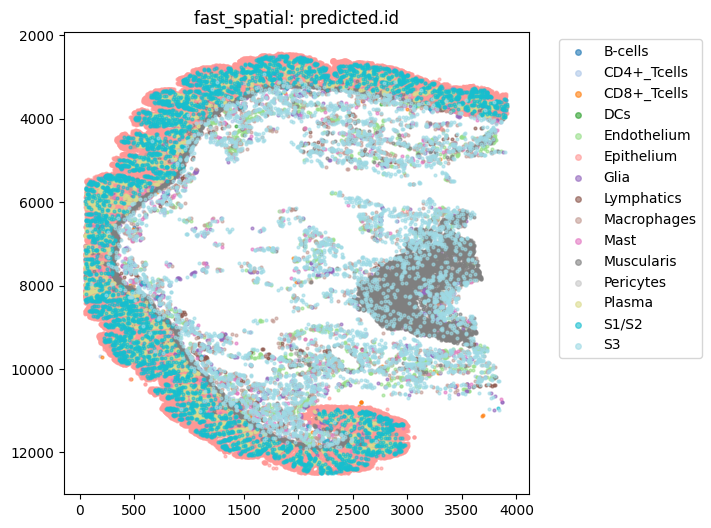

In [19]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


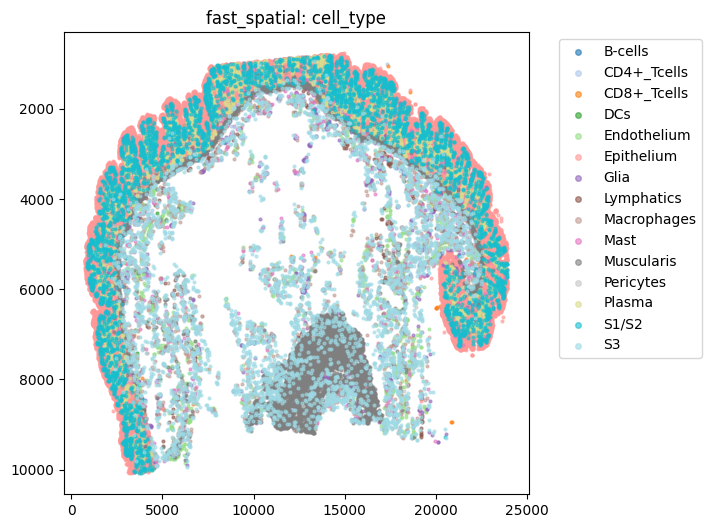

x:[735.1, 23937.8], y:[765.3, 10083.5]


In [20]:
# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [21]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

Before/After: {'old': {'num_cells': 28612, 'cells_under_tissue': 28612, 'transcripts_per_cell': 81.76331609115057, 'total_cell_area': 463568.9892488739}, 'new': {'num_cells': 66455, 'cells_under_tissue': 66455, 'transcripts_per_cell': 115.38504250996915, 'total_cell_area': 1103435.8068981587}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI6/cell_plot.png


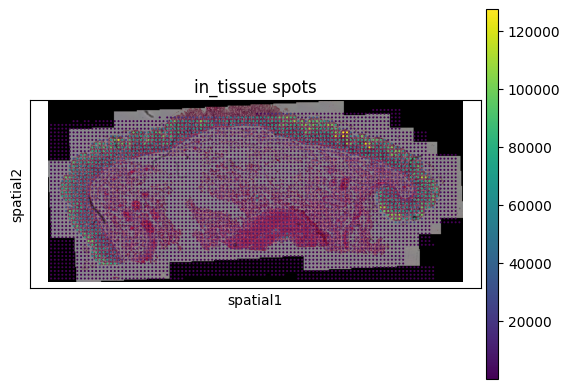

In [22]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI7

In [2]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


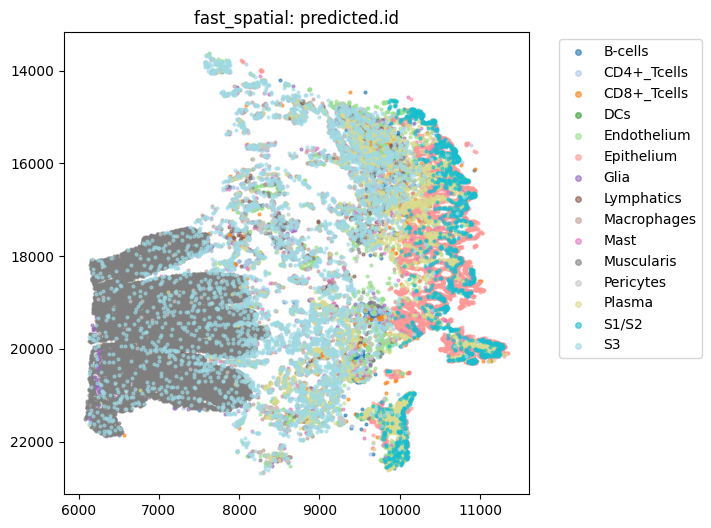

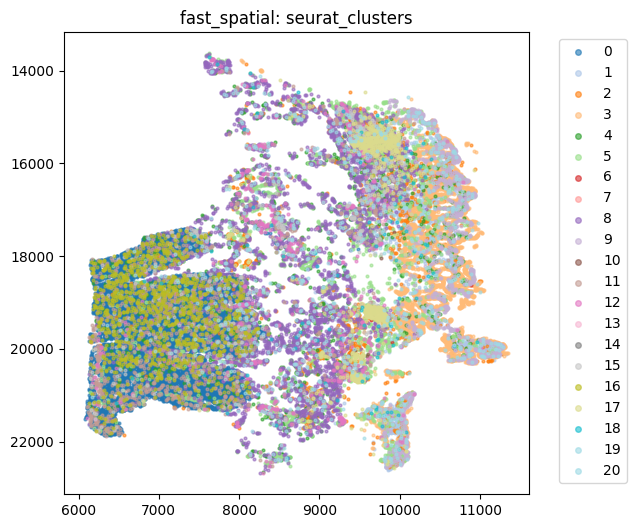

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


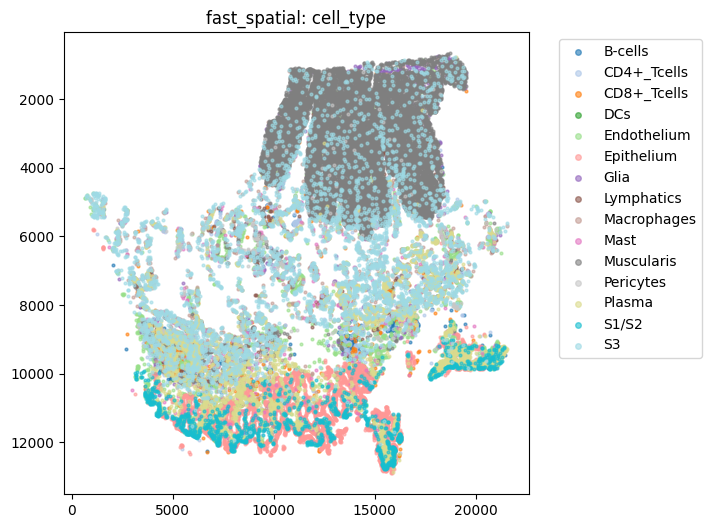

x:[643.4, 21563.5], y:[660.1, 12904.2]


In [8]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 4210, 'cells_under_tissue': 4210, 'transcripts_per_cell': 58.615676959619954, 'total_cell_area': 64490.26836702101}, 'new': {'num_cells': 39354, 'cells_under_tissue': 39354, 'transcripts_per_cell': 76.94305534380241, 'total_cell_area': 611439.9356792163}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


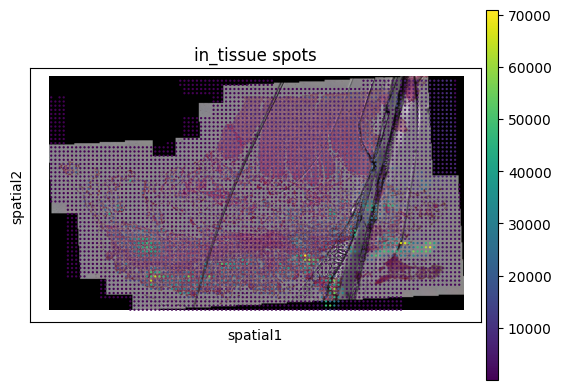

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI7/cell_plot.png


In [9]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S1ROI8

In [10]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/OX932_stitched.ome.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/OX932_stitched.ome_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


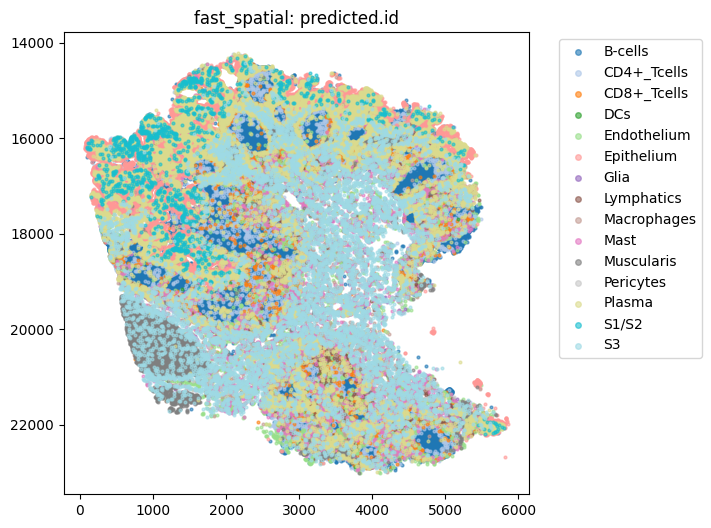

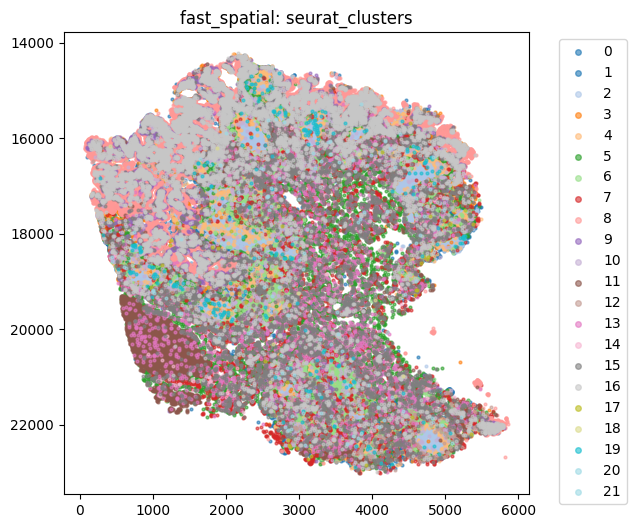

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


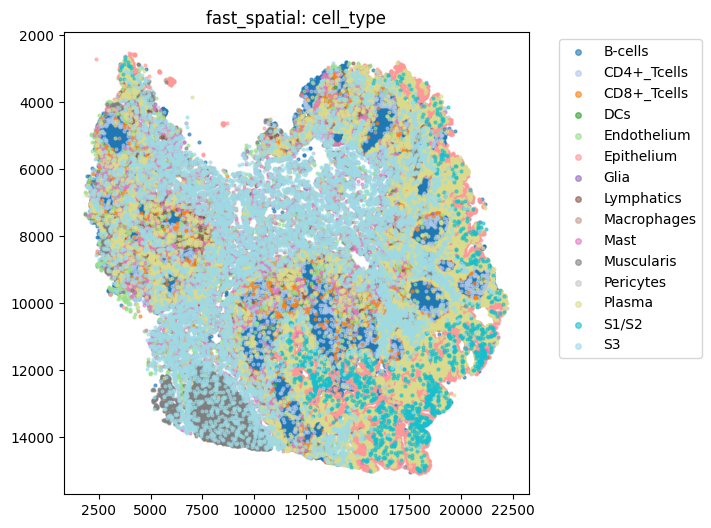

x:[1817.2, 22239.1], y:[2543.4, 15073.9]


In [20]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI8.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 141857, 'cells_under_tissue': 141857, 'transcripts_per_cell': 108.0582769972578, 'total_cell_area': 2390081.5213944633}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


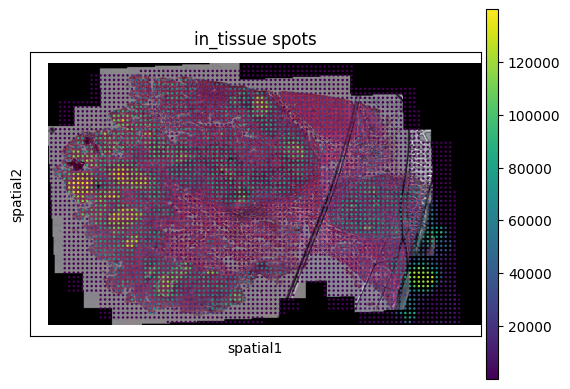

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI8/cell_plot.png


In [12]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI8")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI1

In [13]:
# only change sample ID once here
sample_id = "CAM005"
# exp_stem needs to be changed for slide 2
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


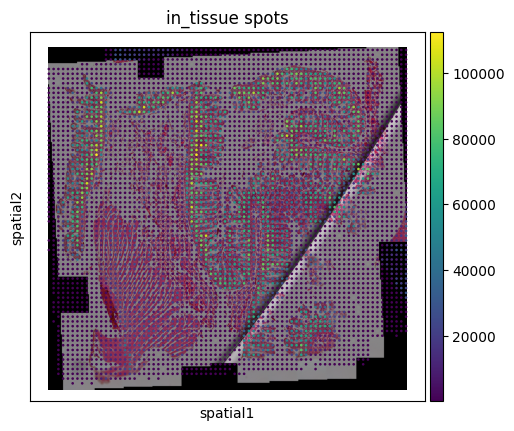

In [17]:
sc.pl.spatial(st.adata,img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")

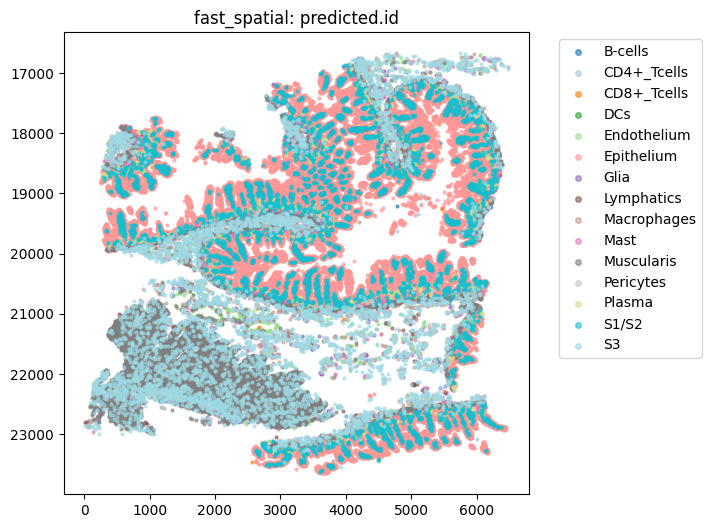

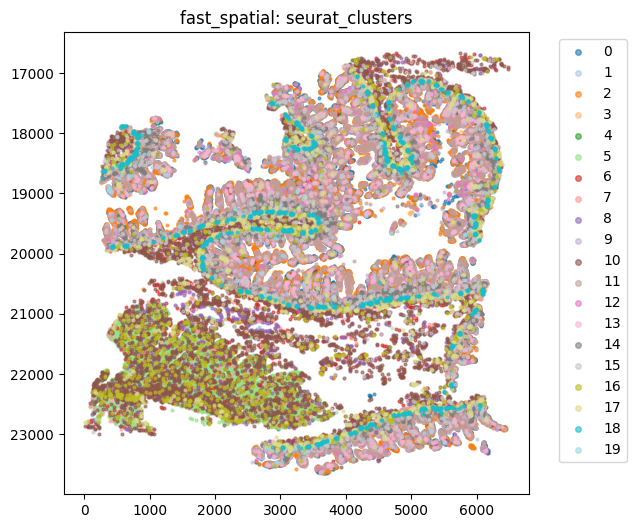

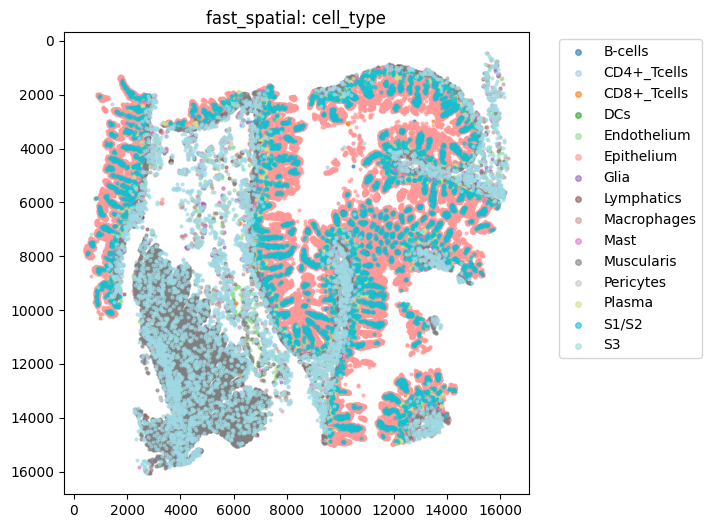

x:[410.4, 16280.8], y:[460.5, 16065.6]


In [21]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

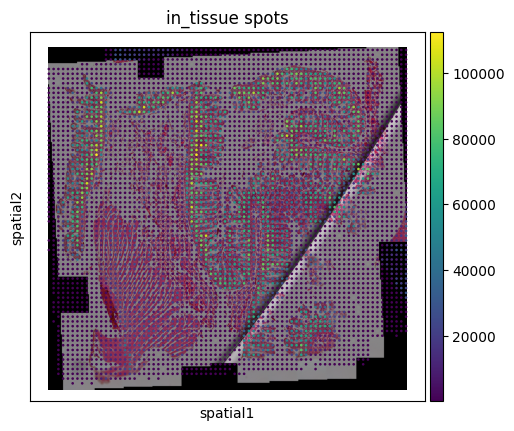

In [22]:
sc.pl.spatial(st.adata,img_key="downscaled_fullres", color = 'total_counts',title=f"in_tissue spots")

Spots kept after rules: 4796 / 4844


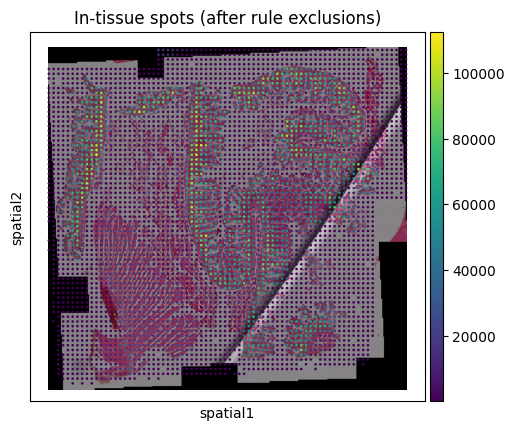

In [34]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "bottom-right", "width": 0.09, "height": 0.55, "units": "frac"},
    {"type": "corner", "corner": "top-left", "width": 0.3, "height": 0.05, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 83080, 'cells_under_tissue': 83080, 'transcripts_per_cell': 115.78176456427539, 'total_cell_area': 1373153.8742773067}, 'new': {'num_cells': 83080, 'cells_under_tissue': 83080, 'transcripts_per_cell': 115.78176456427539, 'total_cell_area': 1373153.8742773067}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


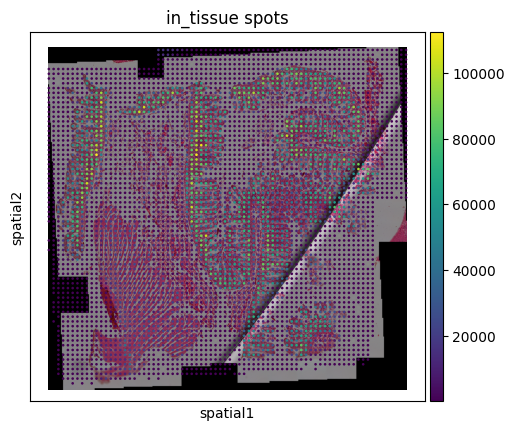

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI1/cell_plot.png


In [35]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep] # only when confirmed bounding box
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI2

In [36]:
# only change sample ID once here
sample_id = "GI9662"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


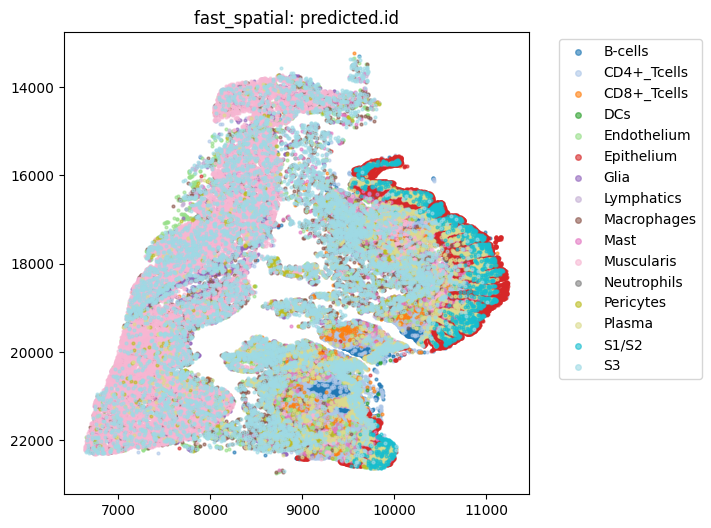

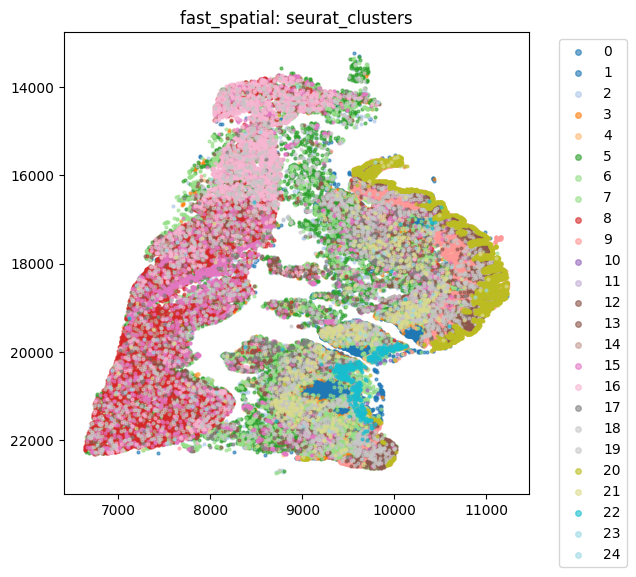

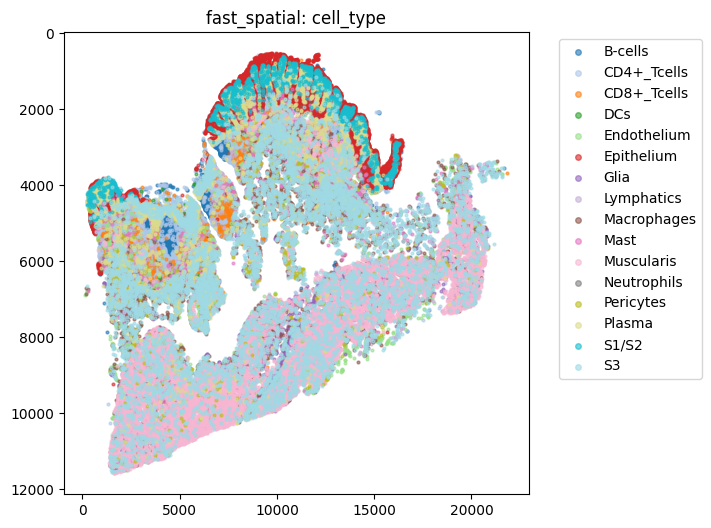

x:[116.4, 21854.5], y:[531.6, 11577.2]


In [37]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI2.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 89095, 'cells_under_tissue': 89095, 'transcripts_per_cell': 109.40207643526573, 'total_cell_area': 1461562.246875331}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


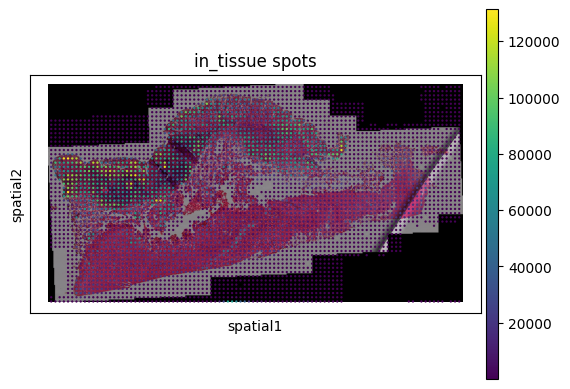

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI2/cell_plot.png


In [38]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI2")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S3ROI3

In [3]:
# only change sample ID once here
sample_id = "GI7051"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [5]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI3.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

#fast_spatial(adata_labelled, 'predicted.id')
#fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
#fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

x:[896.6, 13942.0], y:[1069.7, 11808.6]


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Spots kept after rules: 2818 / 3250


/tmp/ipykernel_1331667/3487448650.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


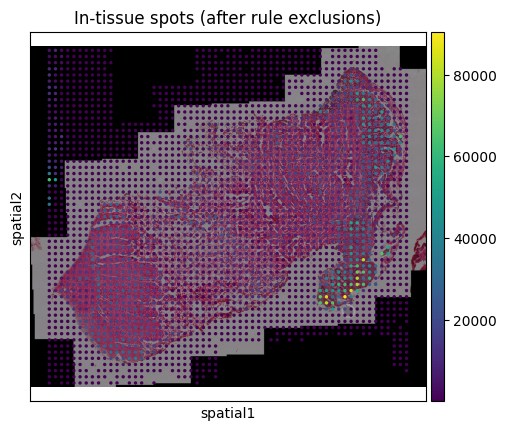

In [7]:
# --- spot exclusions across full WSI ---

# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.09, "units": "frac"},
    {"type": "strip", "side": "left", "size": 0.03, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 27162, 'cells_under_tissue': 27162, 'transcripts_per_cell': 88.31967454532067, 'total_cell_area': 432808.7755936795}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


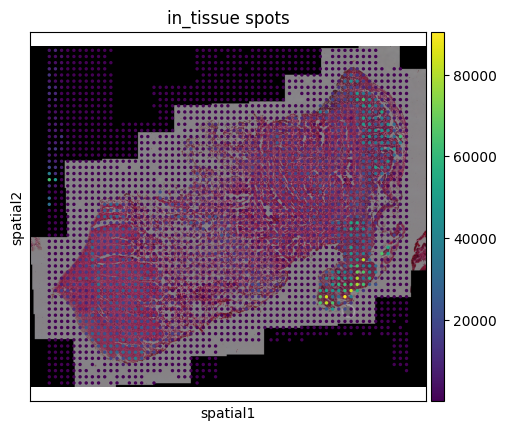

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI3/cell_plot.png


In [8]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI3")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI4

In [9]:
# only change sample ID once here
sample_id = "GI6966"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [11]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI4.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

#fast_spatial(adata_labelled, 'predicted.id')
#fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
#fast_spatial(adata_labelled, 'cell_type')

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Spots kept after rules: 4648 / 4884


/tmp/ipykernel_1331667/3822492696.py:21: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


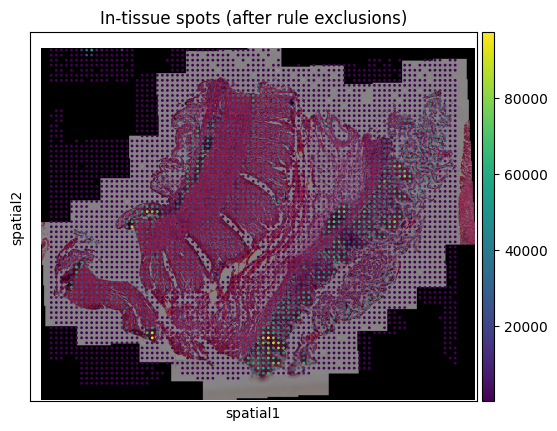

In [14]:
# --- spot exclusions across full WSI ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "right", "size": 0.04, "units": "frac"},
    {"type": "strip", "side": "left", "size": 0.02, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 47925, 'cells_under_tissue': 47925, 'transcripts_per_cell': 86.23106937923839, 'total_cell_area': 766544.4972244431}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


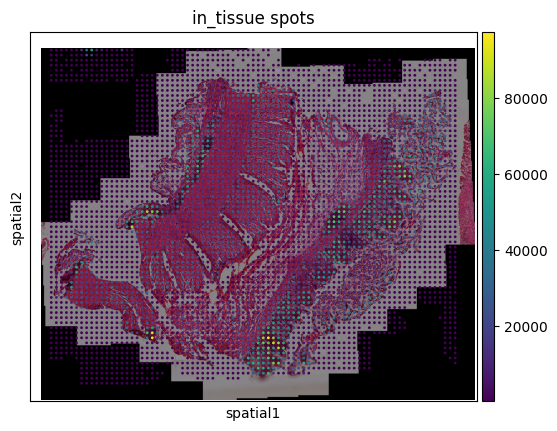

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI4/cell_plot.png


In [15]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI4")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI5

In [6]:
# only change sample ID once here
sample_id = "TIP522"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


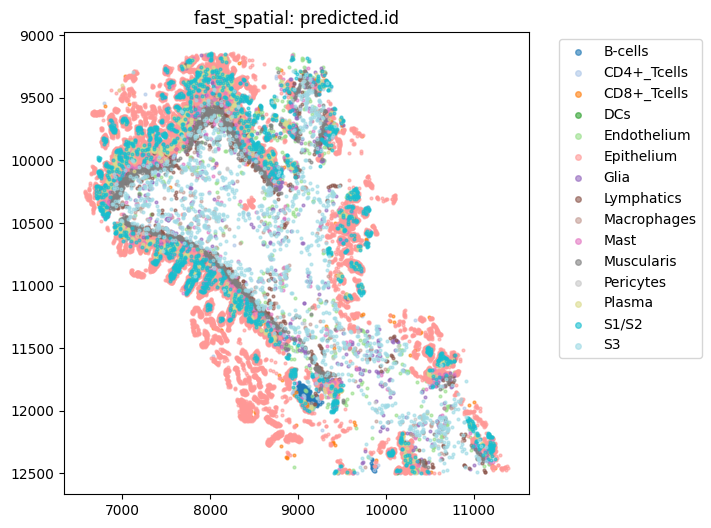

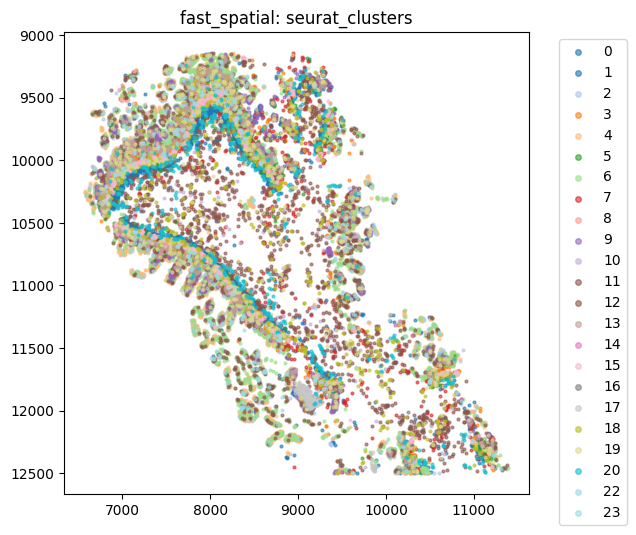

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


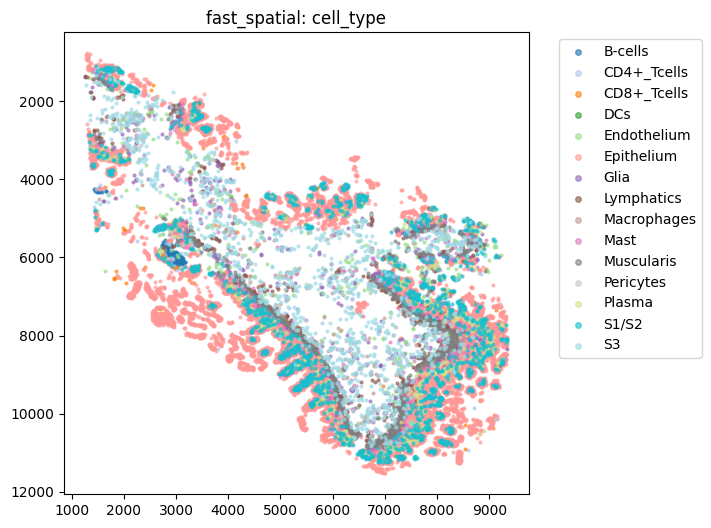

In [7]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI5.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 21234, 'cells_under_tissue': 21234, 'transcripts_per_cell': 123.94358104926062, 'total_cell_area': 353326.6052291087}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:328: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


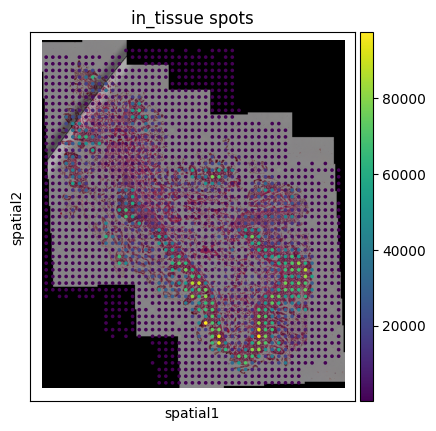

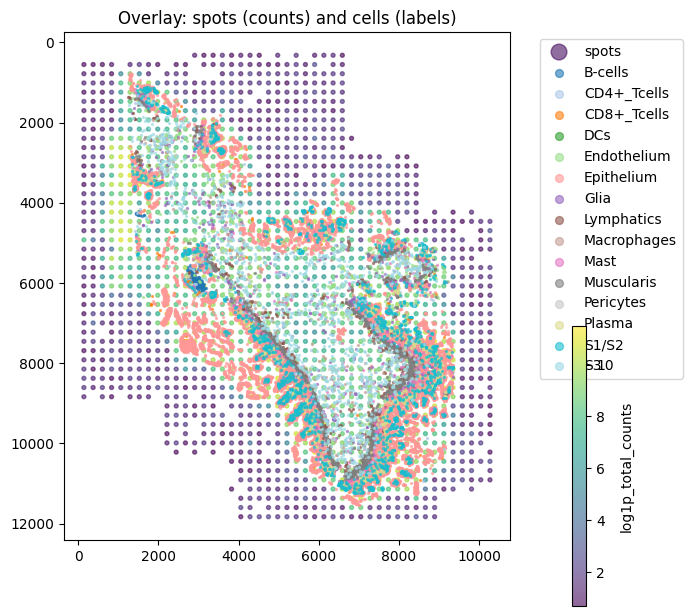

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI5/cell_plot.png


In [8]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI5")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI6

In [9]:
# only change sample ID once here
sample_id = "TIP815"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


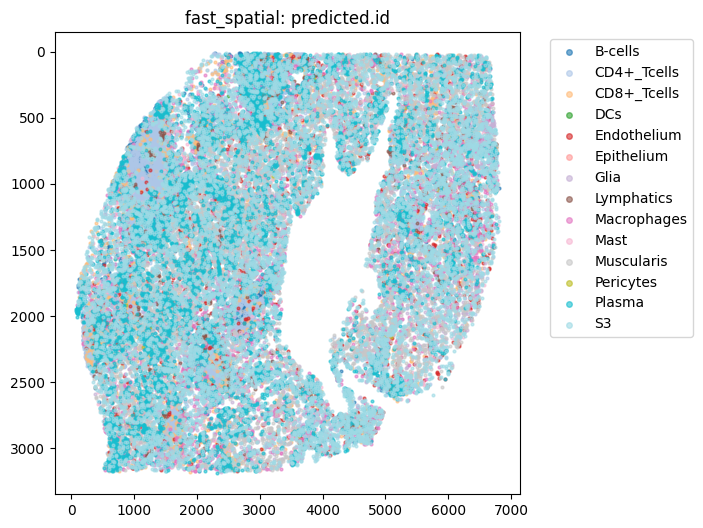

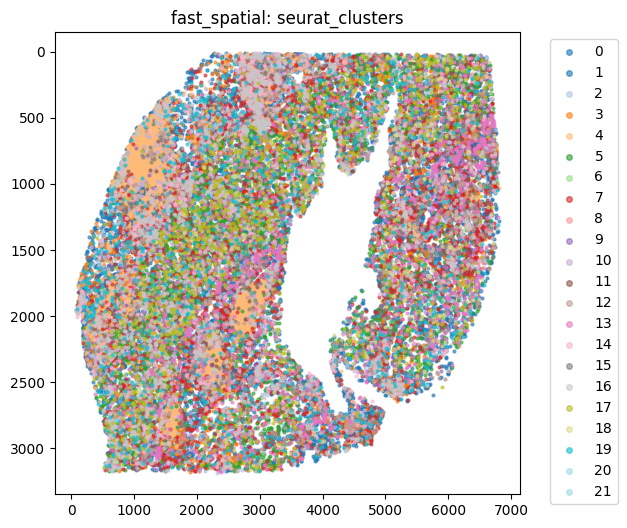

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


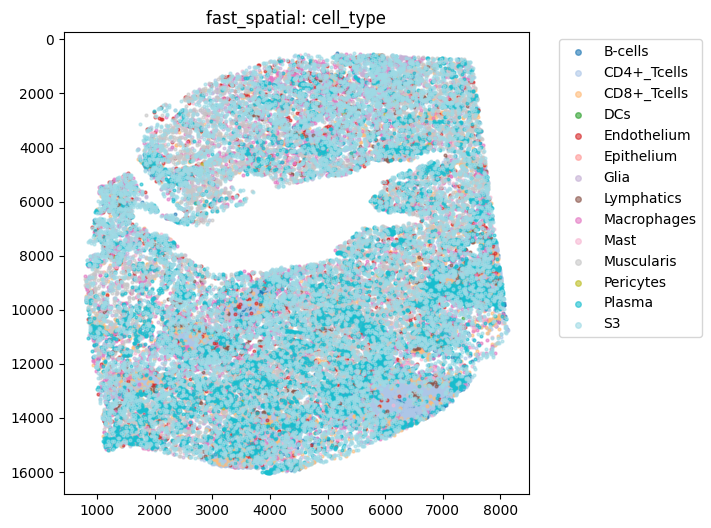

In [10]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Spots kept after rules: 2257 / 2327


/tmp/ipykernel_1389157/3417715046.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


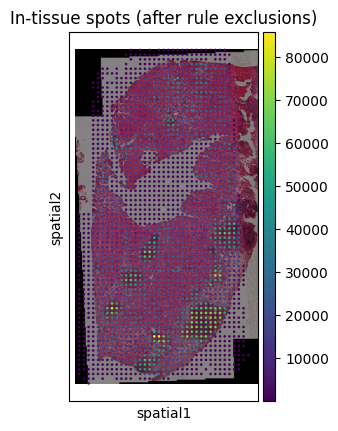

In [17]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "top-left", "width": 0.06, "height": 0.48, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 52284, 'cells_under_tissue': 52284, 'transcripts_per_cell': 95.0392089358121, 'total_cell_area': 833128.6477618205}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:328: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


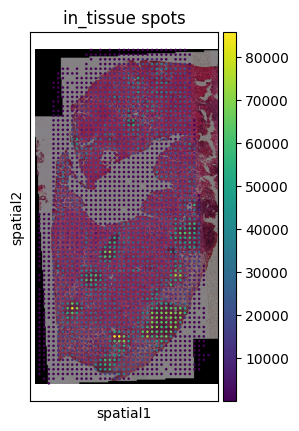

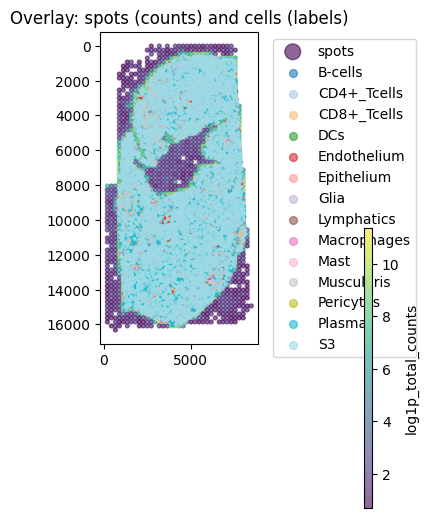

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI6/cell_plot.png


In [18]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR1S2ROI7

In [2]:
# only change sample ID once here
sample_id = "TIP864"
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043720__Region_1__20241113__143611")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE.ome.tif")
align_csv = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/{sample_id}_Xenium5K_post_HnE_matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


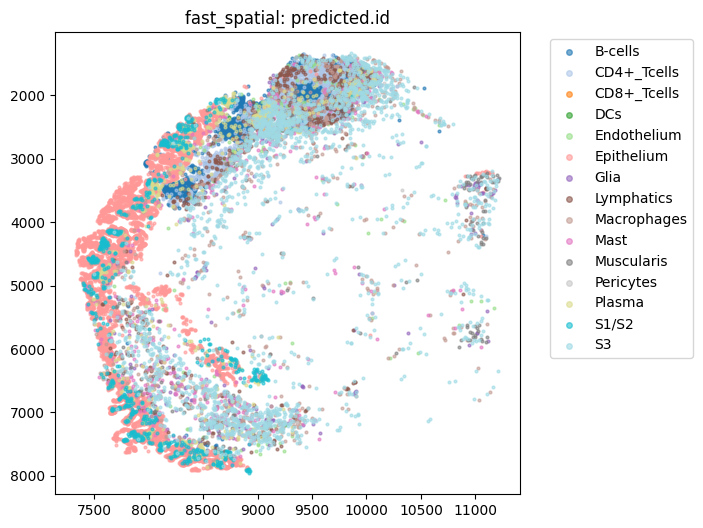

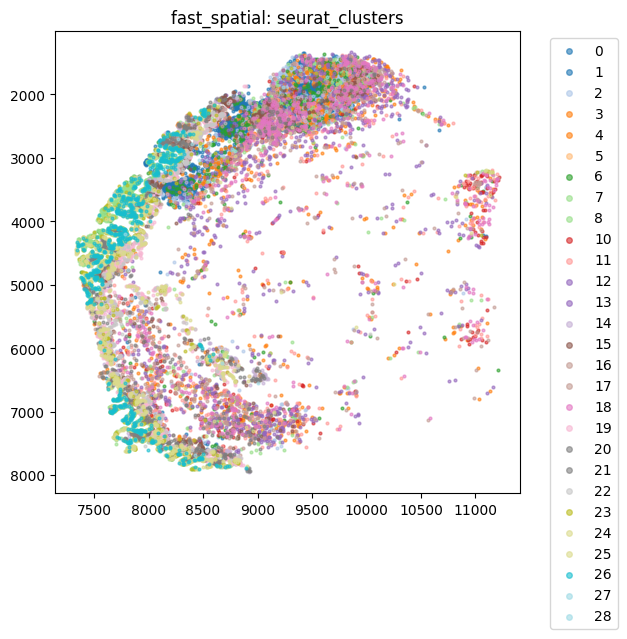

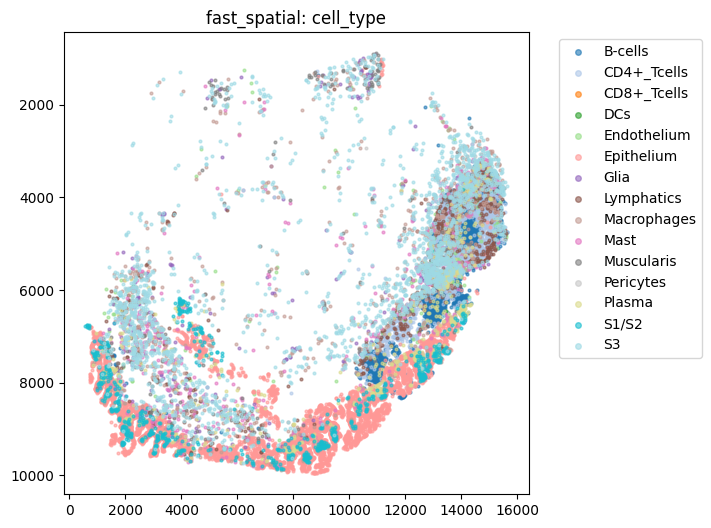

In [3]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S2ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide2/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

Before/After: {'old': {'num_cells': 1090005, 'cells_under_tissue': 1090005, 'transcripts_per_cell': 140, 'total_cell_area': 53266916.81791191}, 'new': {'num_cells': 15941, 'cells_under_tissue': 15941, 'transcripts_per_cell': 58.48886519038956, 'total_cell_area': 245697.36461167}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:317: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


# rescue XeniumPR1S1ROI7

In [9]:
# --- load data ---
exp_stem = Path("/project/simmons_hts/shared/20_11_2024_xenium_prime_run1/20241113__143534__SIMMONS_super_secret_prime_run1/output-XETG00283__0043739__Region_1__20241113__143611")
img_path = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE.ome.tif")
align_csv = Path("/project/simmons_hts/jpark/1_project/0_xenium/RUNTRexBio/post_HnE/GI9613_Xenium5K_post_HnE_matrix.csv")

st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


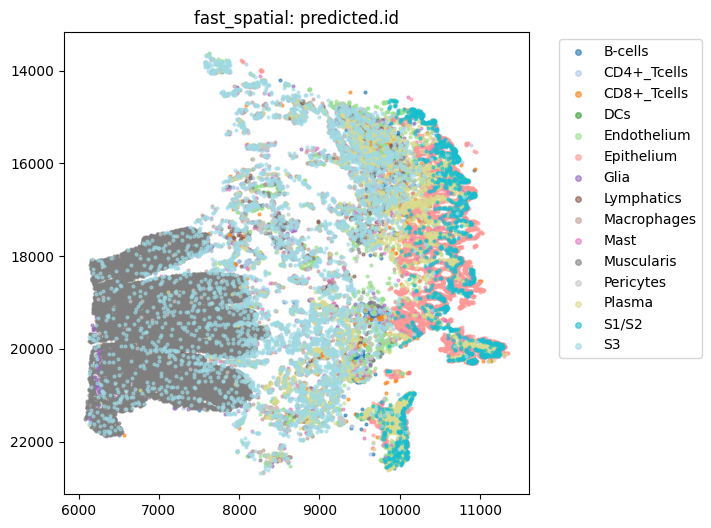

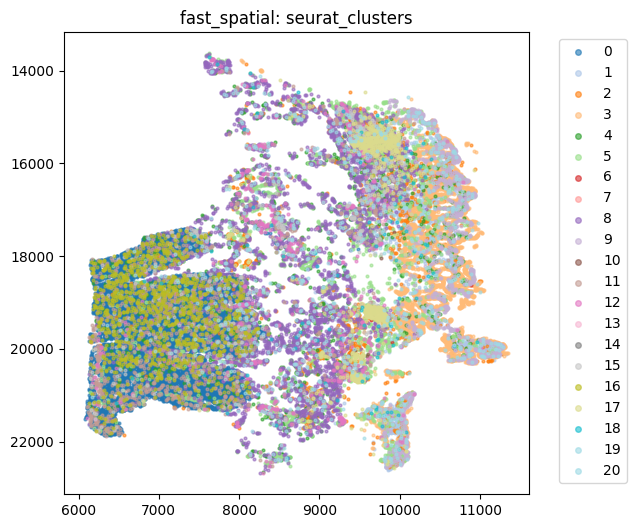

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


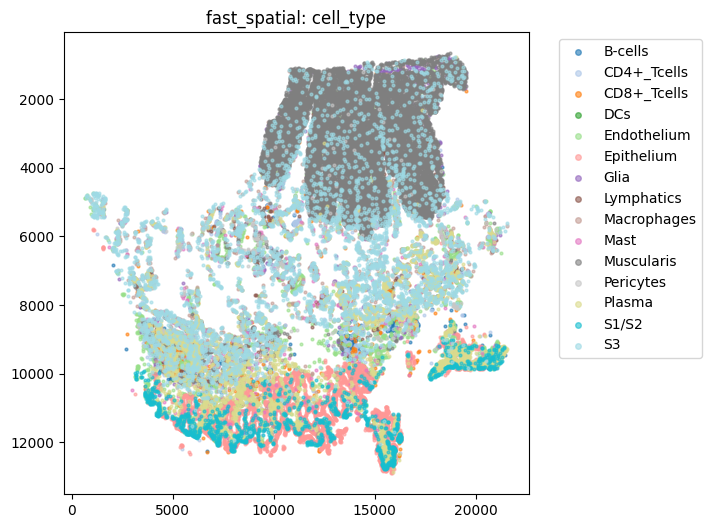

x:[643.4, 21563.5], y:[660.1, 12904.2]


In [11]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR1S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 3528 / 4711


/tmp/ipykernel_2159779/2099021633.py:31: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


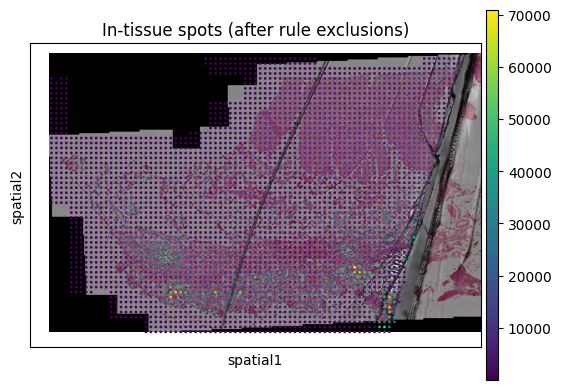

In [43]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    #{"type": "corner", "corner": "bottom-right", "width": 0.2, "height": 0.48, "units": "frac"}
    {'type': 'trapezoid','orientation': 'top','top_width': 0.33,'bottom_width': 0.61,'center_offset': 0.5,'height': 1,'units': 'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

/tmp/ipykernel_2159779/290530728.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


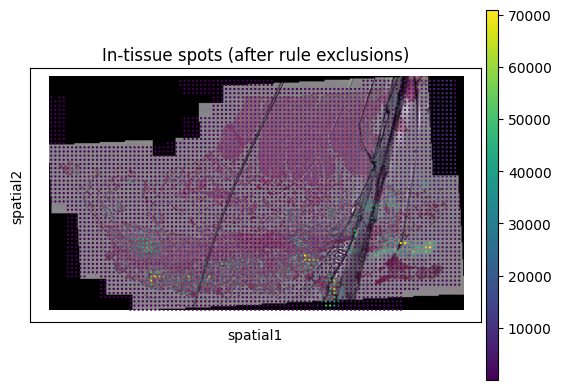

In [7]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1074150, 'cells_under_tissue': 1074150, 'transcripts_per_cell': 156, 'total_cell_area': 55846944.49765815}, 'new': {'num_cells': 39354, 'cells_under_tissue': 39354, 'transcripts_per_cell': 76.94305534380241, 'total_cell_area': 611439.9356792163}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


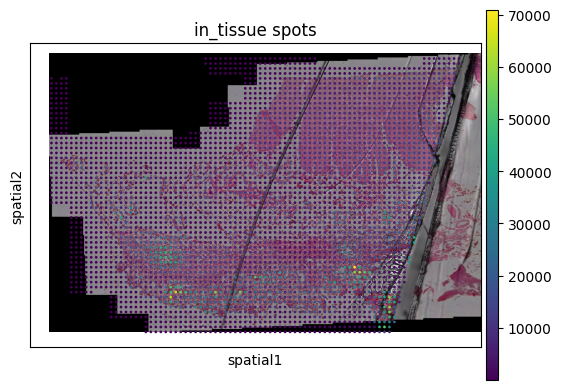

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI7/cell_plot.png


In [44]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR1_segger/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR2

## XeniumPR2S1ROI1

In [2]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI1"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


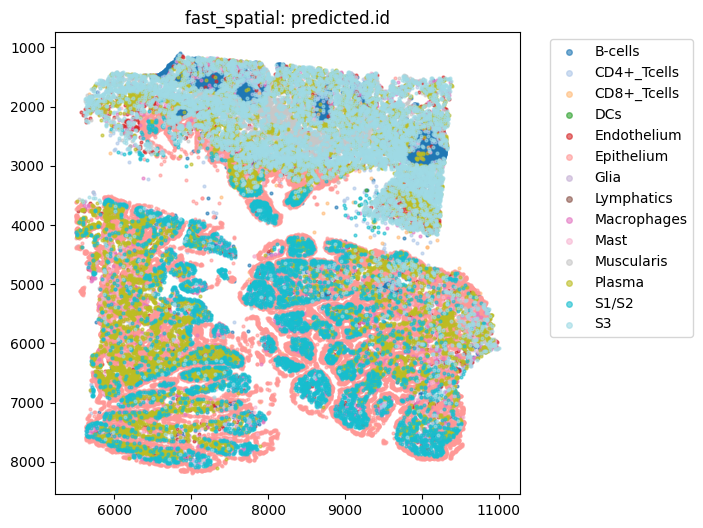

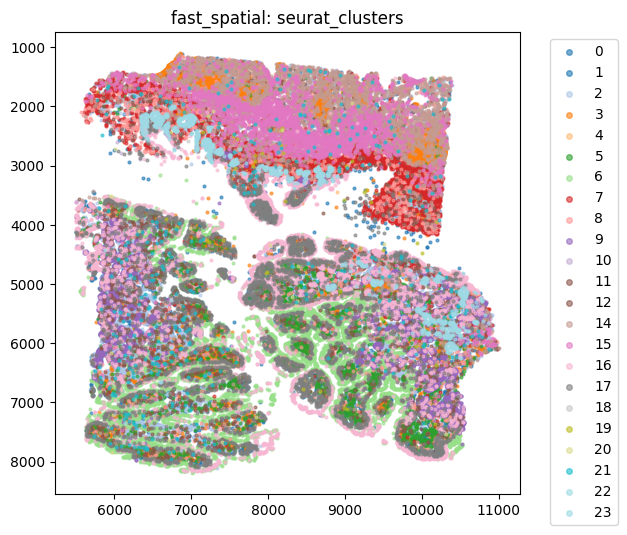

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

Before/After: {'old': {'num_cells': 1145572, 'cells_under_tissue': 1145572, 'transcripts_per_cell': 79, 'total_cell_area': 68598724.10881652}, 'new': {'num_cells': 61910, 'cells_under_tissue': 61910, 'transcripts_per_cell': 62.46574059118075, 'total_cell_area': 1004457.9481054926}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:319: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


/tmp/ipykernel_418154/290530728.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


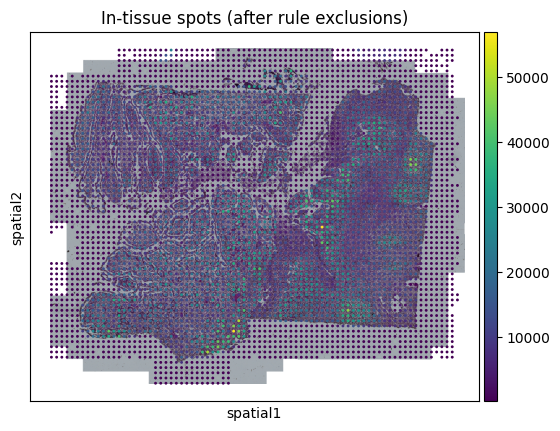

In [6]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

## XeniumPR2S1ROI2

In [7]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI2"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


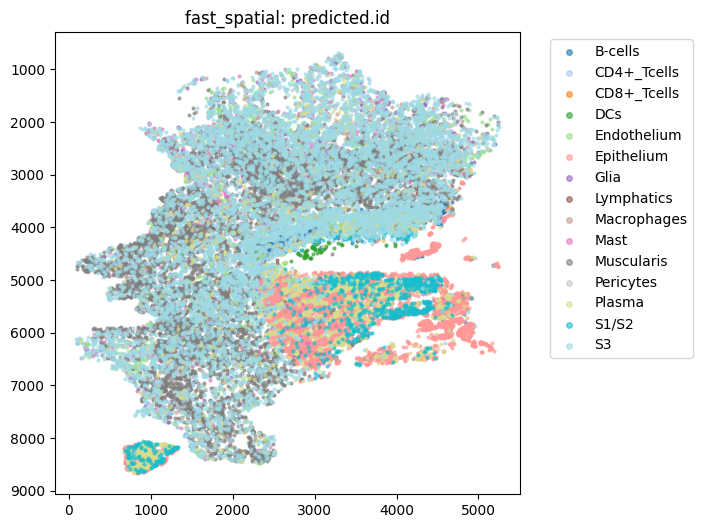

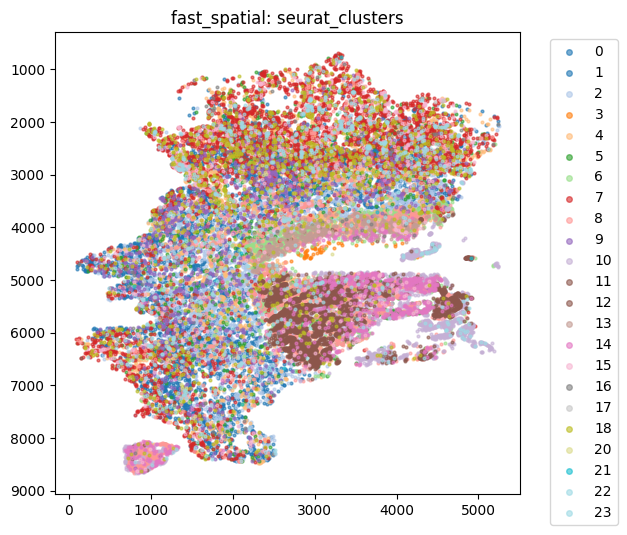

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [8]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI2.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

Spots kept after rules: 3902 / 3946


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_418154/4134725923.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


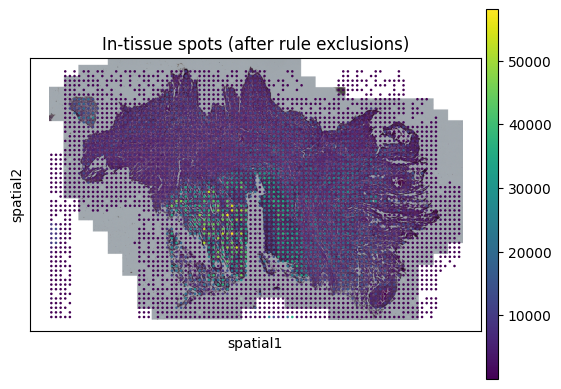

In [16]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "corner", "corner": "top-left", "width": 0.03, "height": 0.4, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [13]:
adata = st.adata

In [ ]:
st.adata = adata

In [18]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI2")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR2S1ROI3

In [19]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI3"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [20]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI3.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [23]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [22]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI3")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR2S1ROI4

In [2]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI4"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


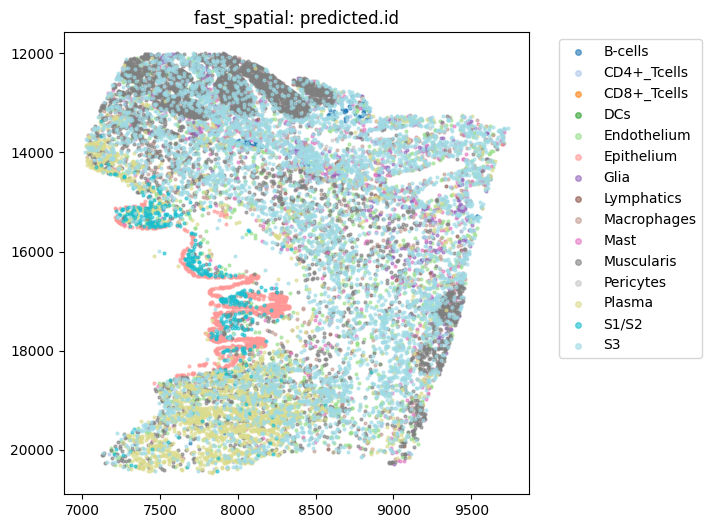

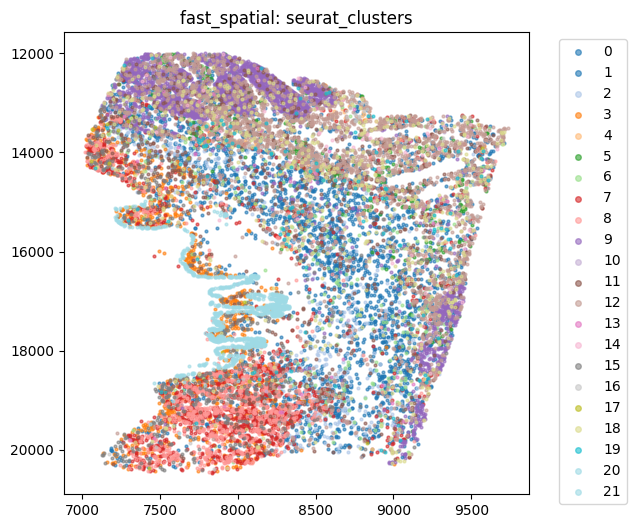

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI5.h5ad") #mismatching h5ad

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

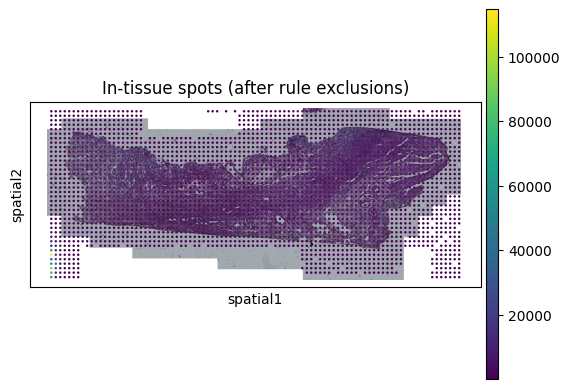

In [4]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [11]:
adata = st.adata

In [12]:
st.adata = adata

Spots kept after rules: 2778 / 2922


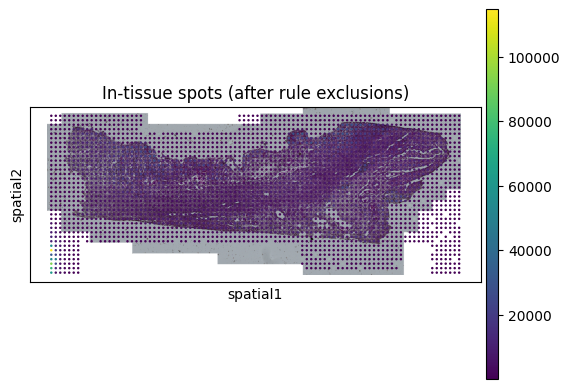

In [13]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "top", "size": 0.05, "units": "frac"}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 25580, 'cells_under_tissue': 25580, 'transcripts_per_cell': 46.645817044566066, 'total_cell_area': 406824.69578889327}, 'new': {'num_cells': 17443, 'cells_under_tissue': 17443, 'transcripts_per_cell': 50.08536375623459, 'total_cell_area': 268889.1350708032}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


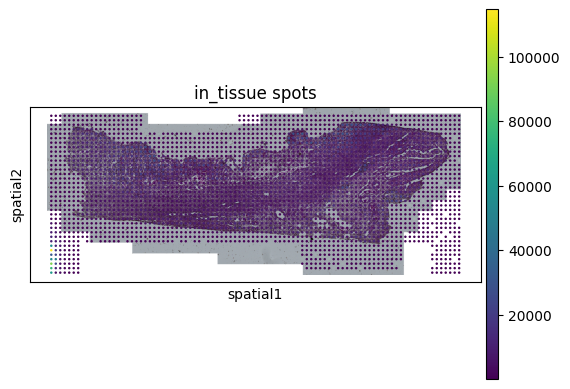

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI4/cell_plot.png


In [14]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI4")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR2S1ROI5

In [ ]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI5"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI4.h5ad") 

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [ ]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI5")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### Edit st

In [26]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI5")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

        'pixel_size' is 0.22044738679715123
        'wsi' is <width=39000, height=32472, backend=CuImageWSI>
        'shapes': []

/tmp/ipykernel_1270489/290530728.py:2: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


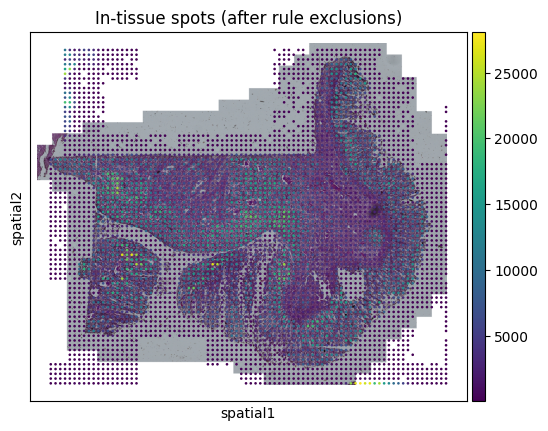

In [ ]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Spots kept after rules: 4641 / 4664


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1270489/1835644194.py:21: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


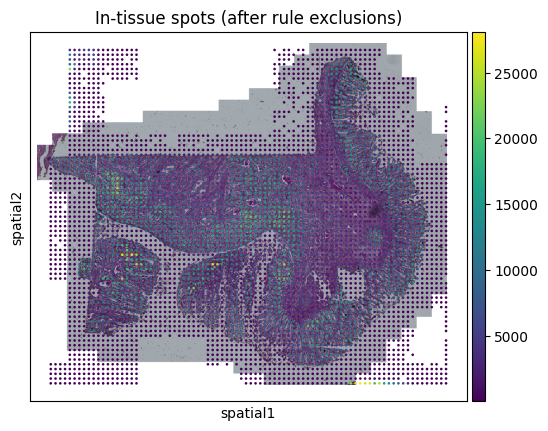

In [28]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "left", "size": 0.03, "units": "frac"},
    {'type':'corner', 'corner':'top-left', 'width':0.07, 'height':0.33, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


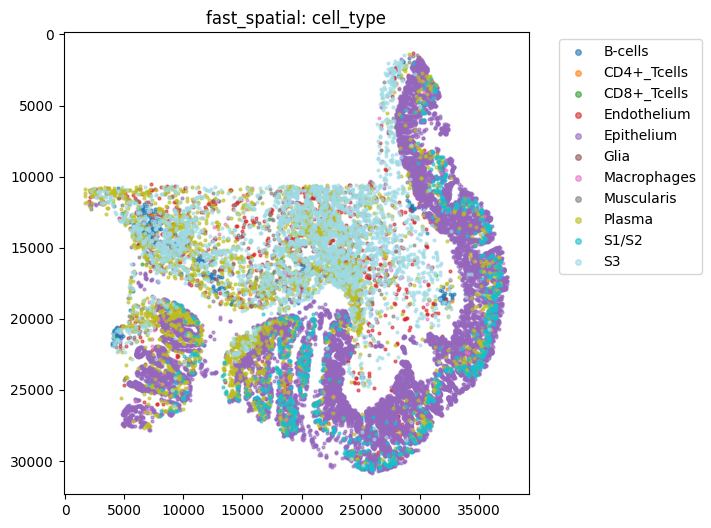

In [29]:
# --- labelled single-cell data ---
sample_id = "RUNcdnec_ROI5"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI4.h5ad") 

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI5")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


Before/After: {'old': {'num_cells': 25580, 'cells_under_tissue': 25580, 'transcripts_per_cell': 46.645817044566066, 'total_cell_area': 406824.69578889327}, 'new': {'num_cells': 25580, 'cells_under_tissue': 25580, 'transcripts_per_cell': 46.645817044566066, 'total_cell_area': 406824.69578889327}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


## XeniumPR2S1ROI6

In [ ]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI6"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### Edit

In [31]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI6")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

        'pixel_size' is 0.22049483980597748
        'wsi' is <width=18874, height=17384, backend=CuImageWSI>
        'shapes': []

Spots kept after rules: 1074 / 1263


/tmp/ipykernel_1270489/3653586903.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


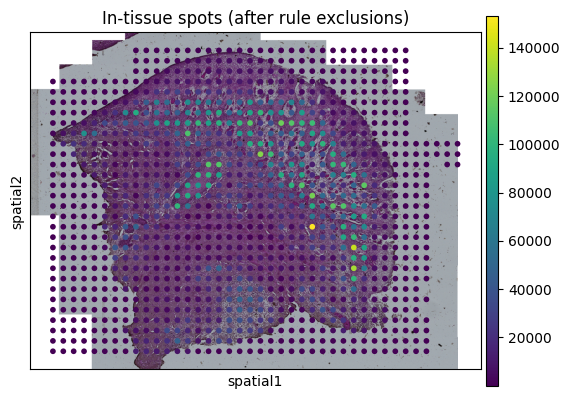

In [ ]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {"type": "strip", "side": "top", "size": 0.07, "units": "frac"},
    {'type':'corner', 'corner':'top-left', 'width':0.24, 'height':0.15, 'units':'frac'},
    {'type':'corner', 'corner':'top-right', 'width':0.1, 'height':0.3, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

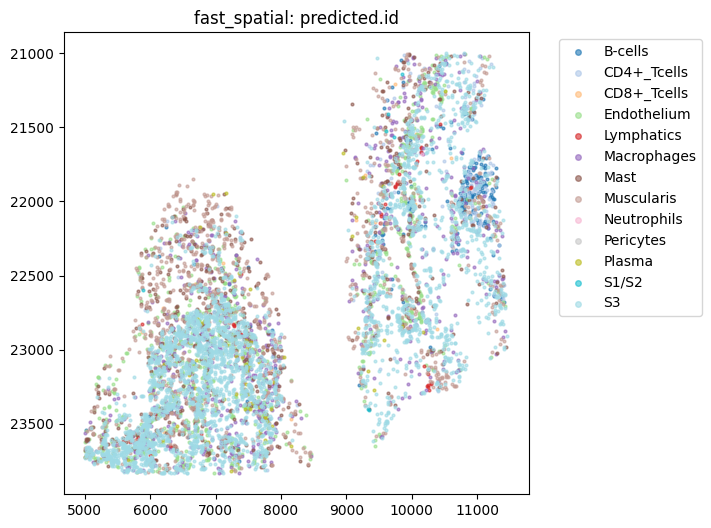

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


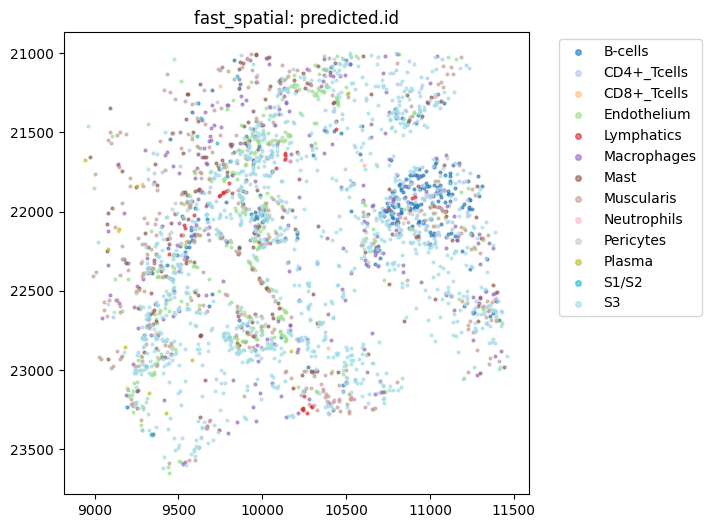

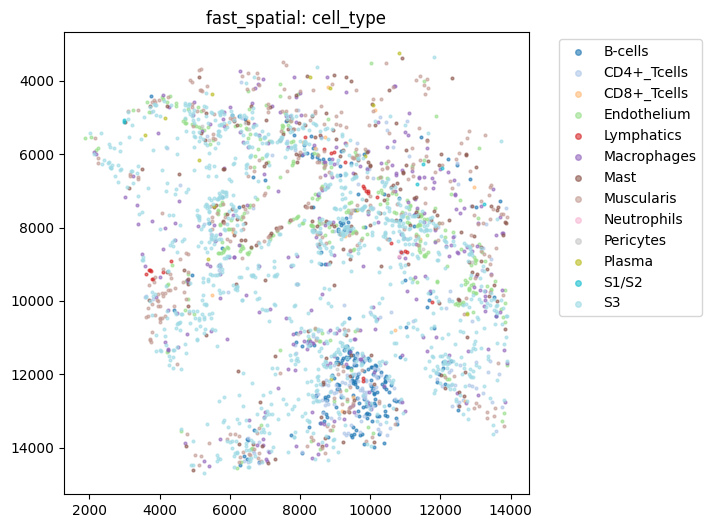

In [55]:
# --- labelled single-cell data ---
sample_id = "RUNcdnec_ROI6"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()
fast_spatial(adata_labelled, 'predicted.id')

# Extract y-coordinates from spatial
x_coords = adata_labelled.obsm["spatial"][:, 0]

# Create a mask for cells with y >= 40000
mask = x_coords >= 8700

# Filter AnnData
adata_labelled = adata_labelled[mask].copy()

fast_spatial(adata_labelled, 'predicted.id')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')


In [ ]:
# reattach (after alignment/renames)
#st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

Before/After: {'old': {'num_cells': 2617, 'cells_under_tissue': 2617, 'transcripts_per_cell': 115.86167367214368, 'total_cell_area': 44105.54280628137}, 'new': {'num_cells': 2617, 'cells_under_tissue': 2617, 'transcripts_per_cell': 115.86167367214368, 'total_cell_area': 44105.54280628137}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


## XeniumPR2S1ROI7

In [ ]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI7"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### edit

In [57]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI7")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

        'pixel_size' is 0.22050080354355434
        'wsi' is <width=21763, height=20608, backend=CuImageWSI>
        'shapes': []

Spots kept after rules: 1193 / 1331


/tmp/ipykernel_1270489/3642907579.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


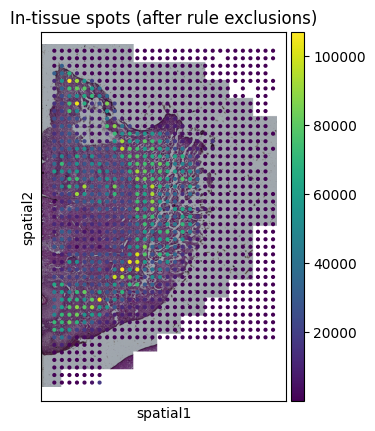

In [72]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'corner', 'corner':'bottom-right', 'width':0.49, 'height':0.13, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

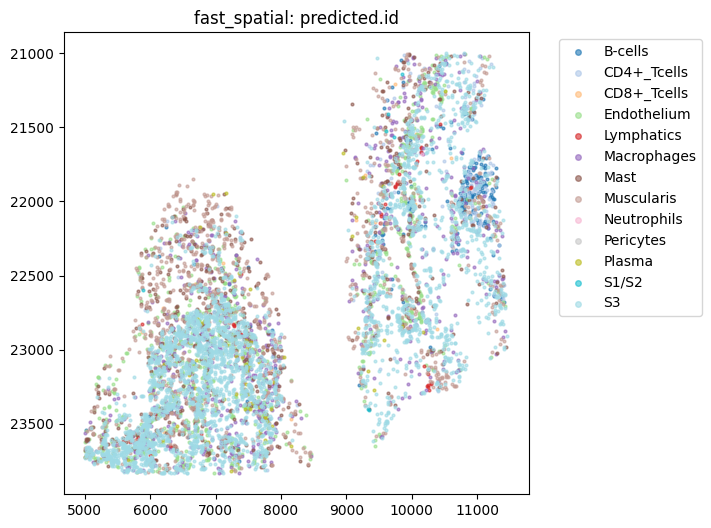

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


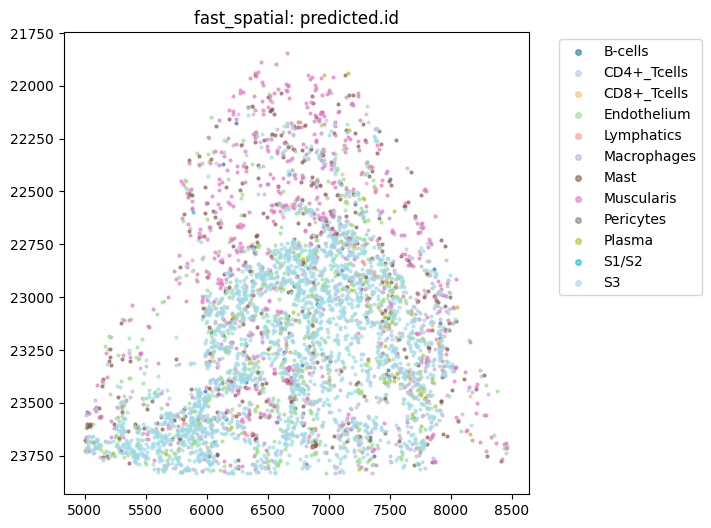

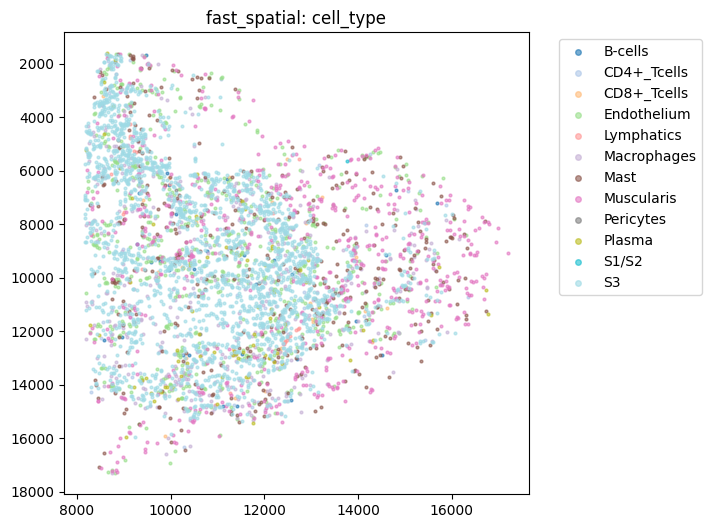

In [73]:
# --- labelled single-cell data ---
sample_id = "RUNcdnec_ROI7"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()
fast_spatial(adata_labelled, 'predicted.id')

# Extract y-coordinates from spatial
x_coords = adata_labelled.obsm["spatial"][:, 0]

# Create a mask for cells 
mask = x_coords < 8700

# Filter AnnData
adata_labelled = adata_labelled[mask].copy()

fast_spatial(adata_labelled, 'predicted.id')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


Before/After: {'old': {'num_cells': 7037, 'cells_under_tissue': 7037, 'transcripts_per_cell': 92.25607503197385, 'total_cell_area': 117134.8444443917}, 'new': {'num_cells': 4420, 'cells_under_tissue': 4420, 'transcripts_per_cell': 78.27963800904978, 'total_cell_area': 73029.30163811034}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


## XeniumPR2S1ROI8

In [75]:
# only change sample ID once here
sample_id = "RUNcdnec_ROI8"
exp_stem = Path("/project/simmons_hts/shared/06_05_2025_xenium_cd_nec_repeat/20250430__120511__VERY_NOT_BORING_XENIUM_PRIME/output-XETG00283__0060560__Region_1__20250430__120544")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNcdnec/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNcdnec/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...


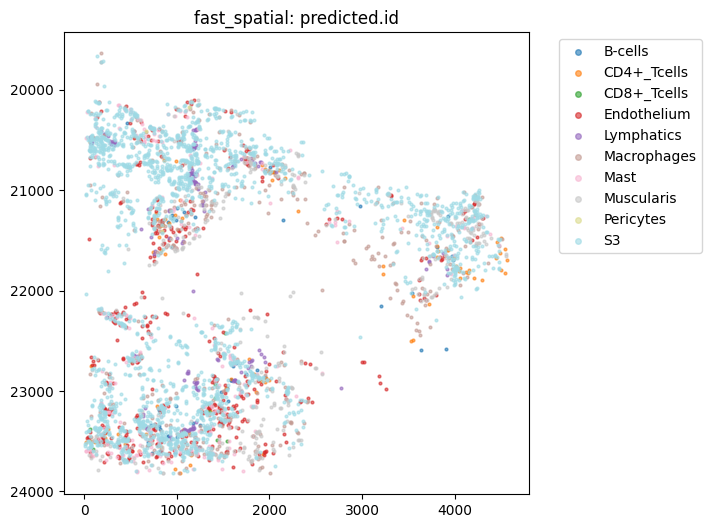

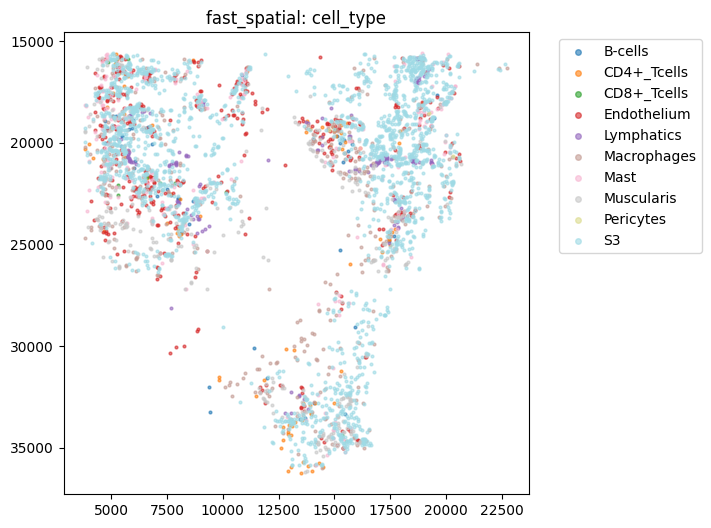

In [76]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR2S1ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

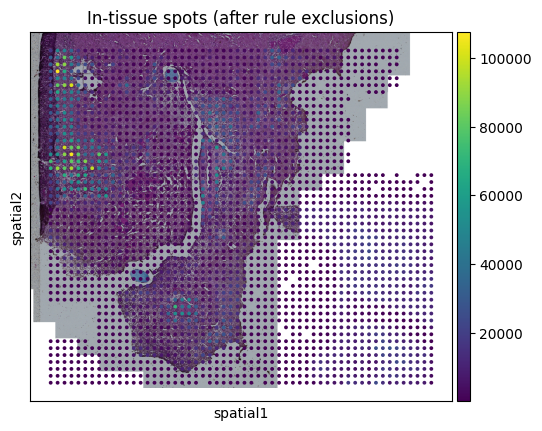

In [ ]:
# visualize with scanpy
sc.pl.spatial(
    st.adata,
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 1145572, 'cells_under_tissue': 1145572, 'transcripts_per_cell': 79, 'total_cell_area': 68598724.10881652}, 'new': {'num_cells': 3698, 'cells_under_tissue': 3698, 'transcripts_per_cell': 105.04975662520282, 'total_cell_area': 61450.30119576237}}
saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


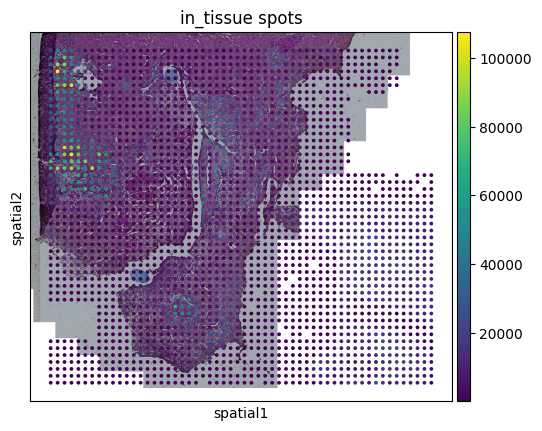

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI8/cell_plot.png


In [78]:
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR2/slide1/ROI8")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR3 (RUNfistula)

## XeniumPR3S1ROI1

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI1"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI1.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

# --- quick sanity range of aligned coords ---
x_min, x_max, y_min, y_max = coord_range(adata_labelled.obsm["spatial"])
print(f"x:[{x_min:.1f}, {x_max:.1f}], y:[{y_min:.1f}, {y_max:.1f}]")

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### edit

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


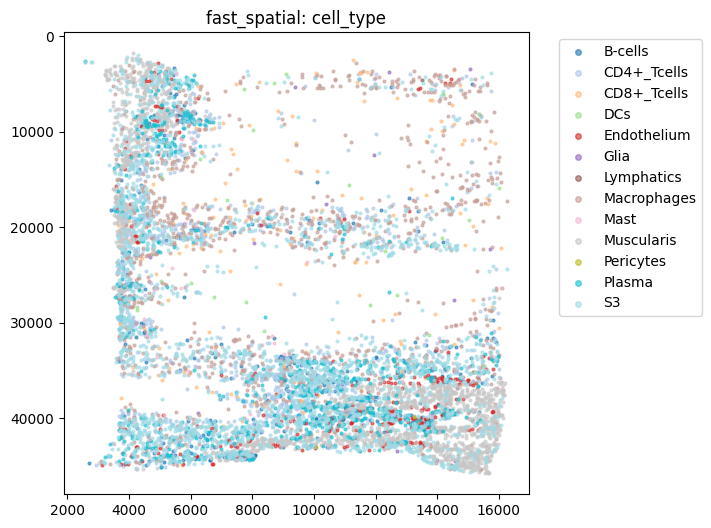

In [3]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI1")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

# --- labelled single-cell data ---
sample_id = "RUNfistula_ROI1"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI1.h5ad") 

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Spots kept after rules: 3363 / 3985


/tmp/ipykernel_1361184/552619951.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


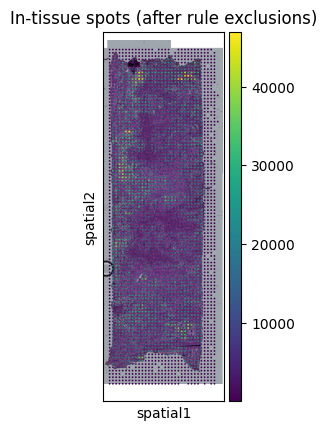

In [7]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'strip', 'side':'left', 'size':0.15, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 7876, 'cells_under_tissue': 7876, 'transcripts_per_cell': 79.5582783138649, 'total_cell_area': 128693.17229770051}, 'new': {'num_cells': 7876, 'cells_under_tissue': 7876, 'transcripts_per_cell': 79.5582783138649, 'total_cell_area': 128693.17229770051}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


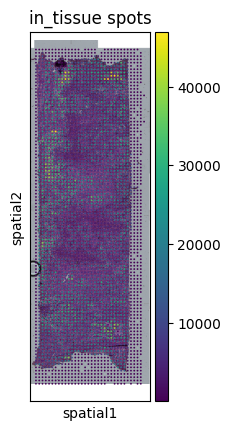

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI1/cell_plot.png


In [8]:
st.adata = st.adata[final_keep]
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI1")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR3S1ROI2

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI2"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI2.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI2")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR3S1ROI3

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI3"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI3.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

fast_spatial(adata_labelled, 'predicted.id')
fast_spatial(adata_labelled, 'seurat_clusters')

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI3")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR3S1ROI4

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI4"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI4.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI4")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### edit

In [9]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI4")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st


        'pixel_size' is 0.22041720307711582
        'wsi' is <width=36130, height=22770, backend=CuImageWSI>
        'shapes': []

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


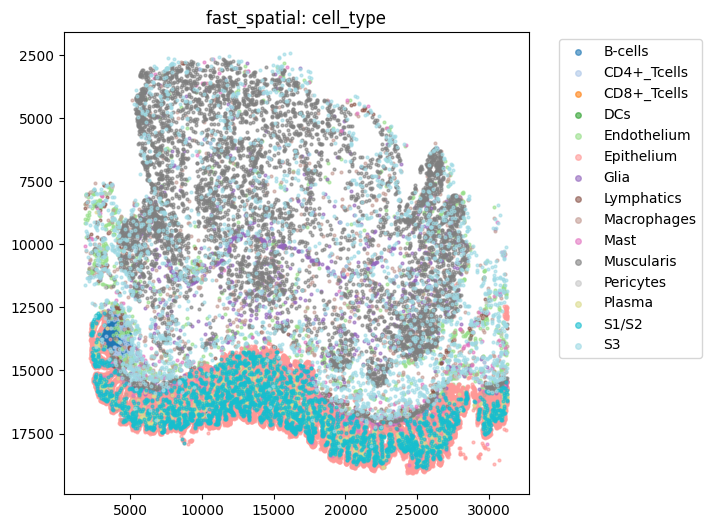

In [19]:
# --- labelled single-cell data ---
# --- labelled single-cell data ---
sample_id = "RUNfistula_ROI4"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI4.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Spots kept after rules: 3285 / 3285


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/tmp/ipykernel_1361184/1424882845.py:20: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


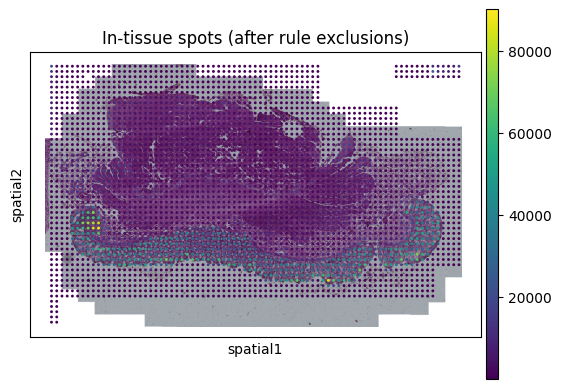

In [20]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'strip', 'side':'left', 'size':0.01, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

Before/After: {'old': {'num_cells': 32643, 'cells_under_tissue': 32643, 'transcripts_per_cell': 91.45556474588733, 'total_cell_area': 518471.9840941041}, 'new': {'num_cells': 32643, 'cells_under_tissue': 32643, 'transcripts_per_cell': 91.45556474588733, 'total_cell_area': 518471.9840941041}}


/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


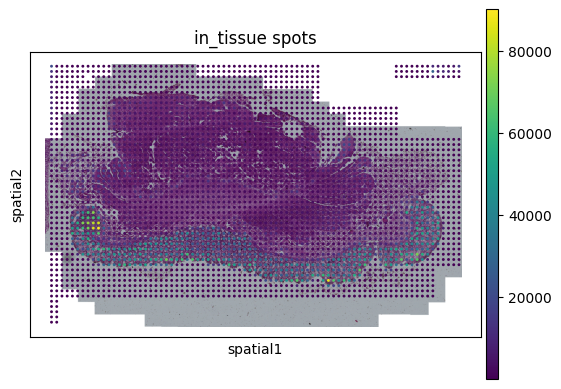

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI4/cell_plot.png


In [21]:
#st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled
# --- meta refresh ---
stats = refresh_meta_counts(st)
print("Before/After:", stats)

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI4")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR3S1ROI5

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI5"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI5.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI5")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# XeniumPR3S1ROI6

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI6"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI6.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### edit

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


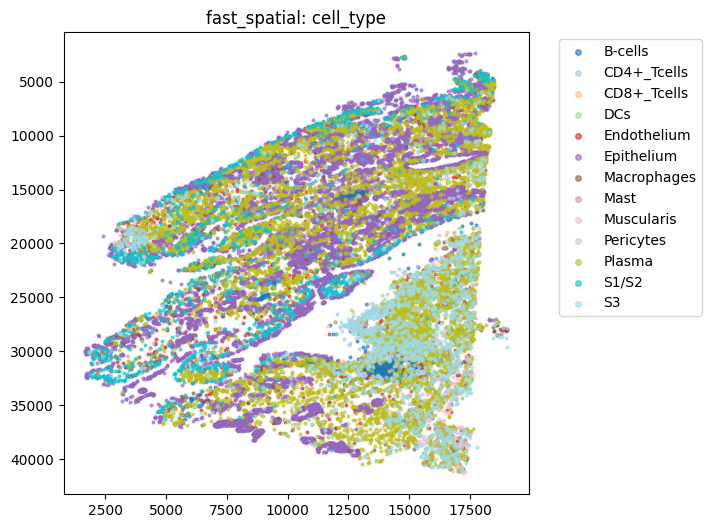

In [24]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI6")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

# --- labelled single-cell data ---
sample_id = "RUNfistula_ROI6"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI8.h5ad") 

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

Spots kept after rules: 3053 / 4057


/tmp/ipykernel_1361184/2293750682.py:22: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  sc.pl.spatial(


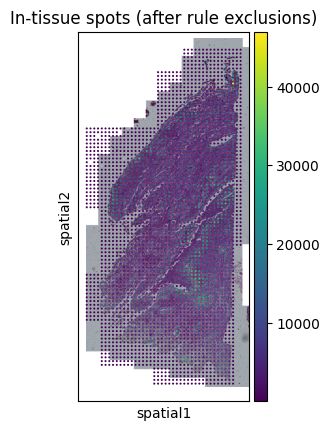

In [32]:
# --- spot exclusions across full WSI (no cell bbox restriction) ---
# get spot coords from st.adata
xy = st.adata.obsm["spatial"]
sx, sy = xy[:, 0], xy[:, 1]

# full WSI bounding box
xmin, xmax, ymin, ymax = 0, st.wsi.width, 0, st.wsi.height

# rules (edit as you like)
rules = [
    {'type':'strip', 'side':'right', 'size':0.13, 'units':'frac'},
    {'type':'corner', 'corner':'top-left', 'width':0.4, 'height':0.25, 'units':'frac'},
    {'type':'corner', 'corner':'bottom-right', 'width':0.18, 'height':0.4, 'units':'frac'}
]

# apply rule-based exclusions directly
final_keep = apply_spot_exclusions(sx, sy, (xmin, xmax, ymin, ymax), rules)

print(f"Spots kept after rules: {final_keep.sum()} / {len(final_keep)}")

# visualize with scanpy
sc.pl.spatial(
    st.adata[final_keep],
    img_key="downscaled_fullres",
    color="total_counts",
    title="In-tissue spots (after rule exclusions)",
)

/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


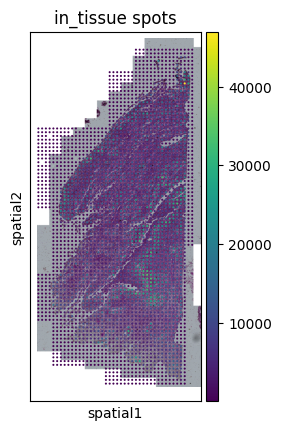

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI6/cell_plot.png


In [33]:
st.adata = st.adata[final_keep]
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI6")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR3S1ROI7

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI7"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI7.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI7")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

## XeniumPR3S1ROI8

In [ ]:
# only change sample ID once here
sample_id = "RUNfistula_ROI8"
exp_stem = Path("/project/simmons_hts/shared/07_04_2025_FISTULA_REVISION_XENIUM_PRIME/output-XETG00283__0060232__Region_1__20250402__131909")
img_path  = Path(f"/project/simmons_hts/jpark/1_project/0_xenium/RUNfistula/post_HnE/{sample_id}.ome.tif")
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
st = load_xenium_dataset(exp_stem, img_path, align_csv, use_dask=True)

In [ ]:
# --- labelled single-cell data ---
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI8.h5ad")

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

In [ ]:
# reattach (after alignment/renames)
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI8")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

### edit

/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


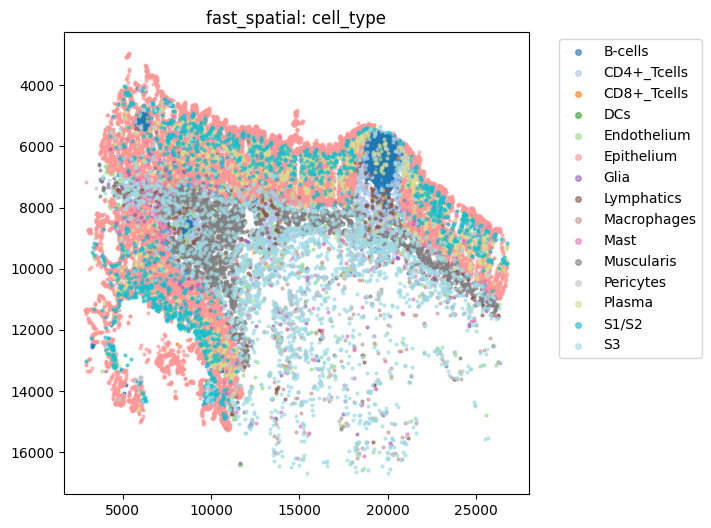

In [40]:
out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI8")
st = read_HESTData(
    str(out_dir / 'aligned_adata.h5ad'), 
    str(out_dir / 'aligned_fullres_HE.tif'), 
    str(out_dir / 'metrics.json')
)
st

# --- labelled single-cell data ---
sample_id = "RUNfistula_ROI8"
align_csv = Path(f"/project/simmons_hts/kxu/xenium/he/5k/RUNfistula/{sample_id}_alignment_files/matrix.csv")
adata_labelled = sc.read_h5ad("/project/simmons_hts/kxu/hest/xenium_labelled/h5ad/XeniumPR3S1ROI6.h5ad") 

adata_labelled.obsm["spatial"] = adata_labelled.obs[["cell_centroid_x","cell_centroid_y"]].to_numpy()

# --- filter st.adata to WSI extent + drop Codeword features ---
update_st_with_filtered_and_labelled(st, adata_labelled, drop_codeword=True)

# --- align labelled cells to H&E pixel coords ---
px_um = st.meta["pixel_size"]
adata_labelled = align_labelled_to_he(adata_labelled, align_csv, pixel_size_um=px_um)

# standardize column names / annotate
adata_labelled = standardize_obs_columns(adata_labelled)
fast_spatial(adata_labelled, 'cell_type')

/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, show=False, img_key="downscaled_fullres", color=[key], title=f"in_tissue spots", return_fig=True, **pl_kwargs)


saving to pyramidal tiff... can be slow


/home/k/kxu/.local/lib/python3.11/site-packages/hest/h5ad_reader.py:324: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


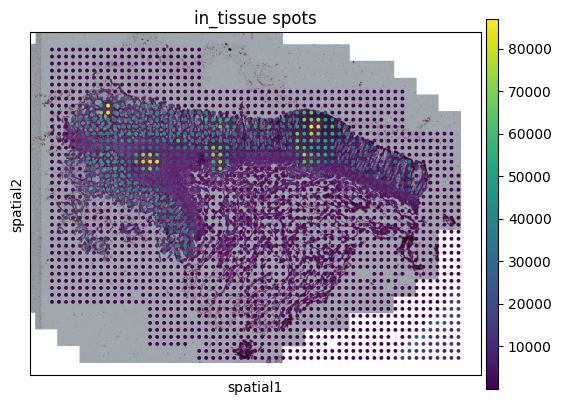

Overlay saved: /project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI8/cell_plot.png


In [41]:
st.cell_adata = adata_labelled

out_dir = Path("/project/simmons_hts/kxu/hest/xenium_data/XeniumPR3/slide1/ROI8")
overlay_path = save_all(st, out_dir, pyramidal=True)
print("Overlay saved:", overlay_path)

# load xenium coeliac 5k

In [2]:
from pathlib import Path
import pandas as pd
import hest
from hest import XeniumReader
import re

# Optional: Dask for parallel processing
import dask

from hest.HESTData import *
from hest import h5ad_reader
from hest.h5ad_reader import *

# Path to metadata Excel file
EXCEL_PATH = "/project/simmons_hts/kxu/hest/xenium_directory.xlsx"

# Where outputs will be written
BASE_OUT_ROOT = Path("/project/simmons_hts/kxu/hest/xenium_data")


In [3]:
metadata = pd.read_excel(EXCEL_PATH)
metadata.head()

,Sample_ID,Technology,Panel,Panel_name,Patient ID,run_name,run,Slide,Slide_ID,Roi,...,Location,Directory,czi,PostHnE,alignment,directory,rds,alignment_note,crop_100_um,segmentation_target_pxl_size
0,XeniumPR1S1ROI1,10x Xenium,5k,NaN,CAM006,RUNTrexBIO,PR1,SLIDE1,43739.0,1.0,...,Colon,/project/simmons_hts/jpark/1_project/0_xenium/...,NaN,CAM006_Xenium5K_post_HnE.ome.tif,CAM006_Xenium5K_post_HnE_matrix.csv,/project/simmons_hts/shared/20_11_2024_xenium_...,/project/simmons_hts/jpark/1_project/1_objects...,NaN,"{""type"": ""strip"", ""side"": ""right"", ""size"": 0.1...",NaN
1,XeniumPR1S1ROI2,10x Xenium,5k,NaN,TIP877,RUNTrexBIO,PR1,SLIDE1,43739.0,2.0,...,Colon,/project/simmons_hts/jpark/1_project/0_xenium/...,NaN,TIP877_Xenium5K_post_HnE.ome.tif,TIP877_Xenium5K_post_HnE_matrix.csv,/project/simmons_hts/shared/20_11_2024_xenium_...,/project/simmons_hts/jpark/1_project/1_objects...,NaN,NaN,NaN
2,XeniumPR1S1ROI3,10x Xenium,5k,NaN,GI9389,RUNTrexBIO,PR1,SLIDE1,43739.0,3.0,...,Colon,/project/simmons_hts/jpark/1_project/0_xenium/...,NaN,GI9389_Xenium5K_post_HnE.ome.tif,GI9389_Xenium5K_post_HnE_matrix.csv,/project/simmons_hts/shared/20_11_2024_xenium_...,/project/simmons_hts/jpark/1_project/1_objects...,NaN,"{'type':'corner', 'corner':'top-left', 'width'...",NaN
3,XeniumPR1S1ROI4,10x Xenium,5k,NaN,GI9077,RUNTrexBIO,PR1,SLIDE1,43739.0,4.0,...,Colon,/project/simmons_hts/jpark/1_project/0_xenium/...,NaN,GI9077_Xenium5K_post_HnE.ome.tif,GI9077_Xenium5K_post_HnE_matrix.csv,/project/simmons_hts/shared/20_11_2024_xenium_...,/project/simmons_hts/jpark/1_project/1_objects...,NaN,"{'type':'corner', 'corner':'bottom-left', 'wid...",NaN
4,XeniumPR1S1ROI5,10x Xenium,5k,NaN,GI9612,RUNTrexBIO,PR1,SLIDE1,43739.0,5.0,...,Colon,/project/simmons_hts/jpark/1_project/0_xenium/...,NaN,GI9612_Xenium5K_post_HnE.ome.tif,GI9612_Xenium5K_post_HnE_matrix.csv,/project/simmons_hts/shared/20_11_2024_xenium_...,/project/simmons_hts/jpark/1_project/1_objects...,NaN,NaN,NaN


In [4]:
def process_sample(sample_id):
    """
    Process a single SampleID from the metadata table using Hest/XeniumReader.
    """

    sample_rows = metadata.loc[metadata["Sample_ID"] == sample_id]

    if sample_rows.empty:
        print(f"❌ No entry found for SampleID: {sample_id}")
        return

    # Process each ROI entry for this Sample
    for _, row in sample_rows.iterrows():

        sample = row["Sample_ID"]
        roi = row["Roi"]
        if pd.notnull(roi):
            roi = int(float(roi))

        exp_stem = Path(row["directory"])
        base_img_dir = Path(row["Directory"])

        # Determine slide number
        slide_str = str(row["Slide"])
        match = re.search(r'\d+', slide_str)
        slide_num = int(match.group()) if match else None

        run_name = str(row.get("run", "")).strip()
        base_out_dir = BASE_OUT_ROOT / f"Xenium{run_name}" / f"slide{slide_num}"

        print(f"\n=== Processing sample={sample}, roi={roi}, slide={slide_num}, run={run_name} ===")

        # Build paths
        img_path = base_img_dir / f"{sample}.ome.tif"
        alignment_file = base_img_dir / f"{sample}_alignment_files" / "matrix.csv"
        save_dir = base_out_dir / f"ROI{roi}"

        # Skip existing output
        if save_dir.exists():
            existing = list(save_dir.glob("*.h5ad")) + list(save_dir.glob("*.png"))
            if existing:
                print(f"⚠️ Already processed: {save_dir}, skipping.")
                continue

        save_dir.mkdir(parents=True, exist_ok=True)

        # Run XeniumReader
        reader = XeniumReader().read(
            img_path=str(img_path),
            experiment_path=str(exp_stem / "experiment.xenium"),
            alignment_file_path=str(alignment_file),
            feature_matrix_path=str(exp_stem / "cell_feature_matrix.h5"),
            transcripts_path=str(exp_stem / "transcripts.parquet"),
            cells_path=str(exp_stem / "cells.parquet"),
            nucleus_bound_path=str(exp_stem / "nucleus_boundaries.parquet"),
            cell_bound_path=str(exp_stem / "cell_boundaries.parquet"),
            dapi_path=str(exp_stem / "morphology_focus/morphology_focus_0000.ome.tif"),
            use_dask=True,
        )

        # Filter & update hest object
        update_st_with_filtered_and_labelled(reader, drop_codeword=True)

        # Save output
        reader.save_spatial_plot(save_dir)
        reader.save(save_dir, pyramidal=True)

        print(f"✔ Saved results to {save_dir}")


In [5]:
sample_list = [
    "XeniumPR5S1ROI6", "XeniumPR5S1ROI7", "XeniumPR5S1ROI8", "XeniumPR5S1ROI9",
    "XeniumPR5S1ROI10", "XeniumPR5S2ROI1", "XeniumPR5S2ROI2", "XeniumPR5S2ROI3",
    "XeniumPR5S2ROI4", "XeniumPR5S2ROI5", "XeniumPR5S2ROI6", "XeniumPR5S2ROI7",
    "XeniumPR5S2ROI8", "XeniumPR5S2ROI9", "XeniumPR5S2ROI10", "XeniumPR5S2ROI11"
]


>>> Processing XeniumPR5S1ROI6...

=== Processing sample=XeniumPR5S1ROI6, roi=6, slide=1, run=PR5 ===
Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


Reading cells...


/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/k/kxu/.local/lib/python3.11/site-packages/hestcore/wsi.py:27: UserWarning: CuImage is not available. Ensure you have a GPU and cucim installed to use GPU acceleration.
  warnings.warn("CuImage is not available. Ensure you have a GPU and cucim installed to use GPU acceleration.")
/package/python-cbrg/current/3.11.3/lib/python3.11/site-packages/anndata/_core/anndata.py:1105: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/k/kxu/.local/lib/python3.11/site-packages/hest/HESTData.py:1390: FutureWarning: Use `squidpy.pl.spatial_scatter` instead.
  fig = sc.pl.spatial(adata, s

saving to pyramidal tiff... can be slow
✔ Saved results to /project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide1/ROI6

>>> Processing XeniumPR5S1ROI7...

=== Processing sample=XeniumPR5S1ROI7, roi=7, slide=1, run=PR5 ===
Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...
saving to pyramidal tiff... can be slow
✔ Saved results to /project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide1/ROI7

>>> Processing XeniumPR5S1ROI8...

=== Processing sample=XeniumPR5S1ROI8, roi=8, slide=1, run=PR5 ===
Loading the WSI... (can be slow for large images)
Loading transcripts...
Pooling xenium transcripts in pseudo-visium spots...
Reading cells...
saving to pyramidal tiff... can be slow
✔ Saved results to /project/simmons_hts/kxu/hest/xenium_data/XeniumPR5/slide1/ROI8

>>> Processing XeniumPR5S1ROI9...

=== Processing sample=XeniumPR5S1ROI9, roi=9, slide=1, run=PR5 ===
Loading the WSI... (can be slow for 

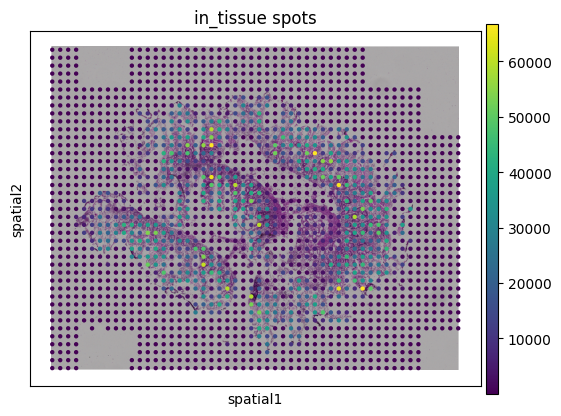

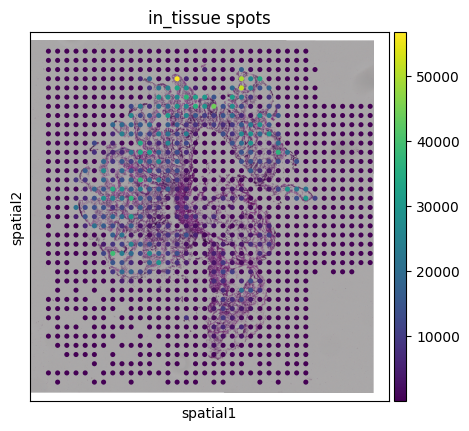

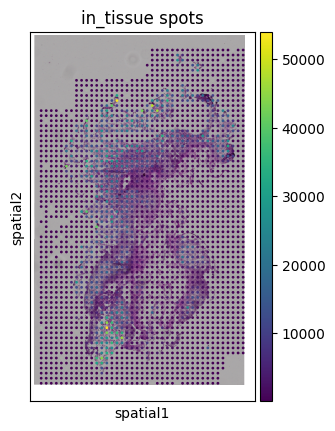

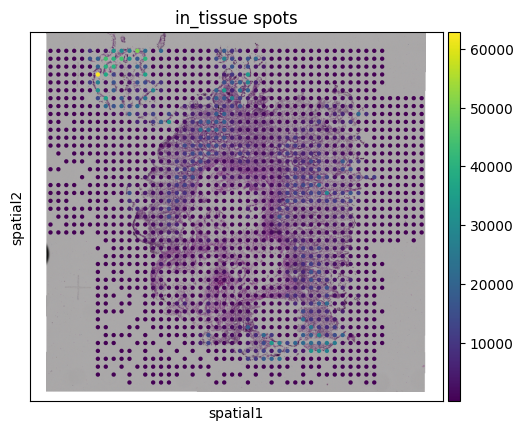

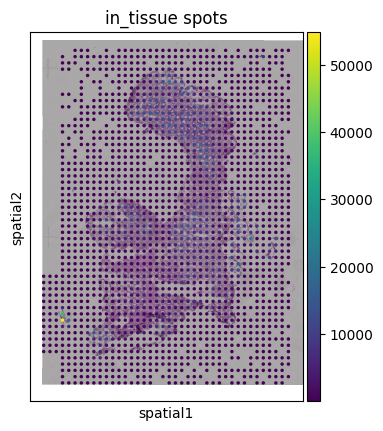

...

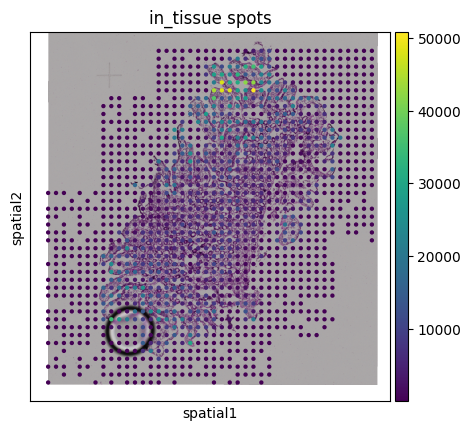

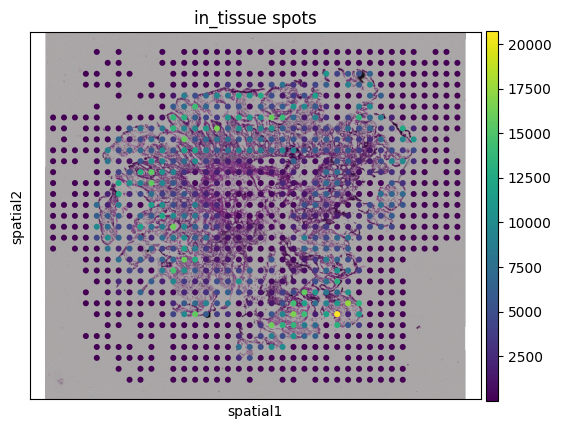

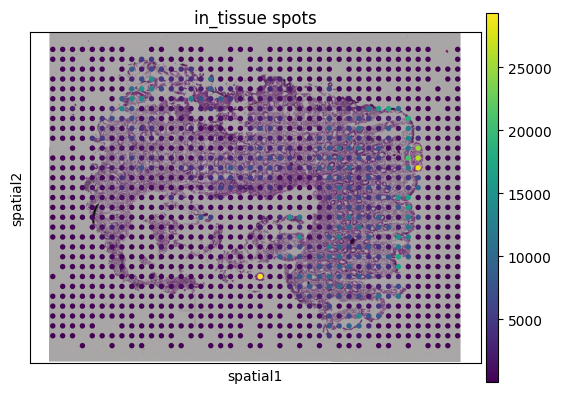

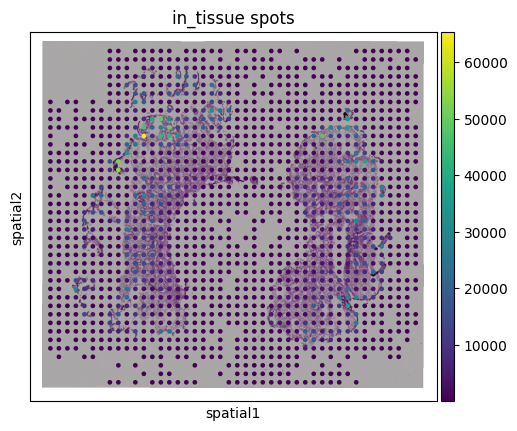

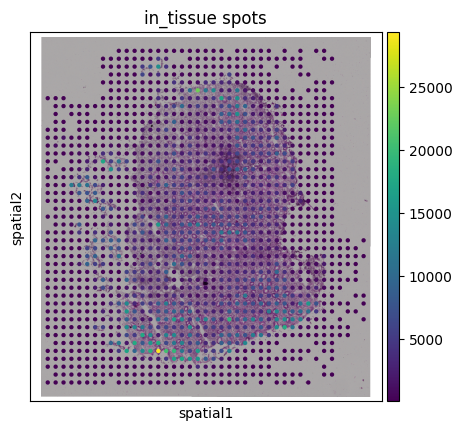

In [6]:
for sample_id in sample_list:
    print(f"\n>>> Processing {sample_id}...")
    process_sample(sample_id)